# **Accidents segons causa conductor gestionats per la Guàrdia Urbana a la ciutat de Barcelona**

## **Introducción**

### Contexto del conjunto de Datos

Este conjunto de datos pertenece a la categoría de Ciutat i serveis, específicamente en el apartado de Seguretat. Incluye un listado de los accidentes gestionados por la Guàrdia Urbana en la ciudad de Barcelona. Además, incorpora información sobre el número de lesionados según la gravedad, el número de vehículos implicados y el punto exacto del accidente.

- Gerencia: Gerència d’Àrea de Seguretat, Prevenció i Convivència de la ciutat de Barcelona
- Departamento: Sistemes d’Informació i Telecomunicacions
- Fecha de Publicación: 14/02/2023
- Frecuencia de Actualización: Anual
- Acceso al Conjunto de Datos a través del siguiente enlace:
  "https://opendata-ajuntament.barcelona.cat/data/ca/dataset/accidents_causa_conductor_gu_bcn/resource/5a040155-38b3-4b19-a4b0-c84a0618d363"
- Para más información, puedes visitar el siguiente enlace:
    "http://ajuntament.barcelona.cat/guardiaurbana/ca/node"

### Variables y descripción:

- **01.Numero_expedient**: Número d'expedient de tramitació del accident
- **02.Codi_districte**: Codi del districte de la ciutat de Barcelona on va passar l'accident
- **03.Nom_districte**: Nom del districte de la ciutat de Barcelona on va passar l'accident
- **04.Codi_barri**: Codi del barri
- **05.Nom_barri**: Nom del barri
- **06.Codi_carrer**: Codi del carrer
- **07.Nom_carrer**: Nom_carrer
- **08.Num_postal**: Número de puerta del edificio a la altura de donde se produjo un accidente
- **09.Descripcio_dia_setmana**: Nom del dia de la setmana, de lunes a domingo
- **10.NK_Any**: Any de les observacions, en aquest cas, 2023
- **11.Mes_any**: Mes de l'any
- **12.Nom_mes**: Nom del mes
- **13.Dia_mes**: Dia del mes
- **14.Hora_dia**: Hora del dia
- **15.Descripcio_torn**: Descripció del torn (matí, tarda, nit)
- **16.Descripcio_causa_mediata**: Descripció causa mediata
- **17.Coordenada_UTM_X_ED50**: Coordenada X en format UTM (ED50)
- **18.Coordenada_UTM_Y_ED50**: Coordenada Y en format UTM (ED50)
- **19.Longitud_WGS84**: Coordenada geográfica de Longitud
- **20.Latitud_WGS84**: Coordenada geográfica de Latitud

Nota : 
- Les dades d’aquest dataset complementen les d'Accidents gestionats per la Guàrdia Urbana a la ciutat de Barcelona
- El valor '-1' en una cel·la indica que no es disposa de la dada.

**********

## **Objectivos**

**Objectivos generales**

* Carga y análisis del conjunto de datos 
* Análisis estadístico y exploratorio, visualizaciones e insights
* Preprocesados y limpieza de datos 
* Valorar diferentes modelos de ML y elegir al menos dos de ellos
* Implementa un pipeline que integre el preproceso de datos y creación de modelos ML
* Experimentar, evaluar y comentar el rendimiento de los modelos basado en las métricas y resultaos
* Interpretación de las métricas y de los resultados

**Objectivos específicos**

* Analizar, experimentar con lod datos y modelos para entrenar predecir patrones y/o probabilidades de circulación y accidentes en la ciudad de Barcelona

**Evaluación**

- Correcta depuración y transformación de datos. 
- Correcta documentación del proceso : legibilidad, organitzación i buenas practicas de programación.
- Correcta interpretación de resultados. 


**Objectivos**

* Carga y análisis básico del conjunto de datos 
* Análisis estadístico y (EDA), correlaciones y visualizaciones
* Preprocesados y modelage para el aprendisaje automático: limpieza, correlaciones e interpretación de los datos.
* Creación de modelos no supervisados (k-means y clustering jerárquico), PCA Encontrar número de clústeres óptimo
* Interpretar los resultados.

___________
Entrega: Enviar la URL a un repositorio llamado *ML_unsupervised* que contenga la solución.
URL : **https://github.com/cristinasprogrammingadventure/** 

## **Instalació del entorn i importacions**

In [382]:
# cálculos, dataframes, uso genereal
import pandas as pd
import numpy as np

# visualización
import seaborn as sns
import plotly.express as px
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import colormaps
import folium

# ML
from sklearn import preprocessing
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Importamos otras librerías necesarias

from datetime import datetime
from scipy.stats import shapiro

import warnings
warnings.filterwarnings('ignore')

In [383]:
# Check the Current Working Directory: 
# This will print the current working directory. 
# Ensure the CSV file is in this directory or adjust your file path accordingly.
    
import os
print(os.getcwd())


C:\Users\Buba\Documents\CURSOS-PROGRAMACION\ML_indep-projects\Hackaton_Barcelona-Activa_Oct2024


In [384]:
# Set the Working Directory: 
# If your working directory is different, you can change it to the correct one like this:

os.chdir(r'C:\Users\Buba\Documents\CURSOS-PROGRAMACION\ML_indep-projects\Hackaton_Barcelona-Activa_Oct2024')

In [385]:
# Define ANSI escape codes for bold and red text

bold_red = "\033[1;31m"
bold_dark_green = "\033[1;32m"
blue_color = "\033[1;34m"
reset_format = "\033[0m"

------------------------------------------

## **Carga y análisis estadístico**

In [386]:
# upload dataset
data = pd.read_csv('2023_accidents_causa_conductor.csv')

In [387]:
data.shape

(8897, 20)

In [388]:
# ver descriptión informativa del conjunto de datos
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Numero_expedient          8897 non-null   object 
 1   Codi_districte            8897 non-null   int64  
 2   Nom_districte             8897 non-null   object 
 3   Codi_barri                8897 non-null   int64  
 4   Nom_barri                 8897 non-null   object 
 5   Codi_carrer               8897 non-null   int64  
 6   Nom_carrer                8897 non-null   object 
 7   Num_postal                8893 non-null   object 
 8   Descripcio_dia_setmana    8897 non-null   object 
 9   NK_Any                    8897 non-null   int64  
 10  Mes_any                   8897 non-null   int64  
 11  Nom_mes                   8897 non-null   object 
 12  Dia_mes                   8897 non-null   int64  
 13  Hora_dia                  8897 non-null   int64  
 14  Descripc

Los tipos de datos de las columnas que tenemos son:
    
- float64 (4) - > numéricas decimales o fracciones corresponientes a las coordenadas métricas y GPS
- int64 (7) -> contienen un múmero íntegro, pero no necesariamente son numéricas por naturaleza y pueden ser variables categóricas
- object (9) -> object es un tipo de texto

Se harán verificaciones para ver si hay casos en los que tenemos que cambiar el tipo de datos de una variable para luego poder realizar cálculos de estadística,  correlaciones y entrenar  modelos de aprendisaje automático

In [389]:
data.columns

Index(['Numero_expedient', 'Codi_districte', 'Nom_districte', 'Codi_barri',
       'Nom_barri', 'Codi_carrer', 'Nom_carrer', 'Num_postal ',
       'Descripcio_dia_setmana', 'NK_Any', 'Mes_any', 'Nom_mes', 'Dia_mes',
       'Hora_dia', 'Descripcio_torn', 'Descripcio_causa_mediata',
       'Coordenada_UTM_X_ED50', 'Coordenada_UTM_Y_ED50', 'Longitud_WGS84',
       'Latitud_WGS84'],
      dtype='object')

De entrada, vemos que **'Num_postal '** tiene **un espacio demás al final** y nos puede generar problemas al escribir código en adelante, por lo que deberíamos **quitar el espacio** de su nombre y poner **'Num_postal'**

In [390]:
# Eliminar el espacio adicional al final del nombre de la columna 'Num_postal '
data.rename(columns={'Num_postal ': 'Num_postal'}, inplace=True)

# Verificar que la columna ha sido renombrada
print(data.columns)


Index(['Numero_expedient', 'Codi_districte', 'Nom_districte', 'Codi_barri',
       'Nom_barri', 'Codi_carrer', 'Nom_carrer', 'Num_postal',
       'Descripcio_dia_setmana', 'NK_Any', 'Mes_any', 'Nom_mes', 'Dia_mes',
       'Hora_dia', 'Descripcio_torn', 'Descripcio_causa_mediata',
       'Coordenada_UTM_X_ED50', 'Coordenada_UTM_Y_ED50', 'Longitud_WGS84',
       'Latitud_WGS84'],
      dtype='object')


------------------------------------------

In [391]:
data

,Numero_expedient,Codi_districte,Nom_districte,Codi_barri,Nom_barri,Codi_carrer,Nom_carrer,Num_postal,Descripcio_dia_setmana,NK_Any,Mes_any,Nom_mes,Dia_mes,Hora_dia,Descripcio_torn,Descripcio_causa_mediata,Coordenada_UTM_X_ED50,Coordenada_UTM_Y_ED50,Longitud_WGS84,Latitud_WGS84
0,2023S000699,-1,Desconegut,-1,Desconegut,-1,Rovira (ascendent) ...,0,Dissabte,2023,2,Febrer,4,16,Tarda,Manca d'atenció a la conducció,430443.36,4585232.00,2.166596,41.413783
1,2023S005197,-1,Desconegut,-1,Desconegut,-1,Estatut de Catalunya ...,11,Divendres,2023,9,Setembre,1,13,Matí,No respectar distàncies,429493.73,4587108.15,2.155015,41.430598
2,2023S007430,-1,Desconegut,-1,Desconegut,-1,Rovira (ascendent) ...,0,Divendres,2023,12,Desembre,15,11,Matí,No respectar distàncies,430443.36,4585232.00,2.166596,41.413783
3,2023S000961,-1,Desconegut,-1,Desconegut,-1,Amílcar ...,120,Dissabte,2023,1,Gener,28,14,Tarda,No respectat pas de vianants,430955.45,4586335.10,2.172596,41.423762
4,2023S006486,-1,Desconegut,-1,Desconegut,-1,Augusta / Hort de la Vila ...,NaN,Dijous,2023,11,Novembre,2,14,Tarda,Desobeir semàfor,426883.33,4583690.92,2.124189,41.399587
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8892,2023S000678,8,Nou Barris,44,Vilapicina i la Torre Llobeta,119003,Fabra i Puig,0181 0181,Divendres,2023,2,Febrer,3,17,Tarda,Avançament defectuós/improcedent,431379.36,4587039.88,2.177589,41.430147
8893,2023S006888,8,Nou Barris,44,Vilapicina i la Torre Llobeta,45701,Quinze,0068 0068,Dilluns,2023,11,Novembre,20,14,Tarda,No respectar distàncies,431122.09,4586910.29,2.174525,41.428957
8894,2023S007283,8,Nou Barris,45,Porta,256401,Pintor Alsamora,0001 0001,Divendres,2023,12,Desembre,8,6,Matí,Altres,431890.58,4587477.65,2.183657,41.434133
8895,2023S007283,8,Nou Barris,45,Porta,256401,Pintor Alsamora,0001 0001,Divendres,2023,12,Desembre,8,6,Matí,Manca d'atenció a la conducció,431890.58,4587477.65,2.183657,41.434133


In [392]:
# Ver las estadísticas básicas de las variables numéricas del dataset

data.describe().round()

,Codi_districte,Codi_barri,Codi_carrer,NK_Any,Mes_any,Dia_mes,Hora_dia,Coordenada_UTM_X_ED50,Coordenada_UTM_Y_ED50,Longitud_WGS84,Latitud_WGS84
count,8897.0,8897.0,8897.0,8897.0,8897.0,8897.0,8897.0,8897.0,8897.0,8897.0,8897.0
mean,5.0,27.0,254857.0,2023.0,7.0,16.0,14.0,430088.0,4583704.0,2.0,41.0
std,3.0,22.0,204942.0,0.0,3.0,9.0,5.0,2045.0,2490.0,0.0,0.0
min,-1.0,-1.0,-1.0,2023.0,1.0,1.0,0.0,421374.0,4575152.0,2.0,41.0
25%,2.0,8.0,120603.0,2023.0,4.0,8.0,10.0,428578.0,4582111.0,2.0,41.0
50%,4.0,20.0,196707.0,2023.0,6.0,16.0,14.0,430136.0,4583399.0,2.0,41.0
75%,7.0,43.0,325107.0,2023.0,10.0,23.0,18.0,431575.0,4585169.0,2.0,41.0
max,10.0,73.0,701873.0,2023.0,12.0,31.0,23.0,435086.0,4591182.0,2.0,41.0


In [393]:
data.duplicated().sum()

0

No parece haber filas de valores duplicados (idénticas) 

Con base en el análisis del número de valores únicos (nunique()), podemos identificar diversas transformciones que hacer, identificar columnas que podrían ser buenas candidatas para transformar sus tipos de datos más adelante, optimizar el rendimiento y facilitar el análisis. 


In [394]:
# Vemos los valores únicos de cada uno de los atributos
data.nunique()

Numero_expedient            7721
Codi_districte                11
Nom_districte                 11
Codi_barri                    74
Nom_barri                     74
Codi_carrer                 1074
Nom_carrer                  1053
Num_postal                  1917
Descripcio_dia_setmana         7
NK_Any                         1
Mes_any                       12
Nom_mes                       12
Dia_mes                       31
Hora_dia                      24
Descripcio_torn                3
Descripcio_causa_mediata      16
Coordenada_UTM_X_ED50       4808
Coordenada_UTM_Y_ED50       4804
Longitud_WGS84              4821
Latitud_WGS84               4822
dtype: int64

El conjunto de datos está bien organizado y en cuanto a **datos temporales**, podemos ver que hay 1 año, 12 meses, 24 horas en cada día, 3 turnos (mañana, tarde y noche) y en este sentdo no habrá que hacer limpieza.

**Vamos a ver los datos únicos de algunas columnas:**

**Causas de los accidentes**: 

In [395]:
# Get unique values in 'Descripcio_causa_mediata'

print(data['Descripcio_causa_mediata'].unique())


["Manca d'atenció a la conducció" 'No respectar distàncies'
 'No respectat pas de vianants' 'Desobeir semàfor'
 'Desobeir altres senyals' 'Gir indegut o sense precaució' 'Altres'
 'Desconegut' 'Avançament defectuós/improcedent'
 'Canvi de carril sense precaució' 'No determinada'
 'Manca precaució incorporació circulació' 'No cedir la dreta'
 'Manca precaució efectuar marxa enrera' 'Envair calçada contrària'
 'Fallada mecànica o avaria']


Llama la atención el hecho de no encontrar de manera explícita causas como el alcohl al volante, drogas, incluso somnolencia. Puede ser que estén en "Altres".

Una observación importante es que ***'Descripcio_causa_mediata'*** es una de las variables con datos desconocidos, pero no es lo mismo que un valor nulo, dado que   una causa de accidente puede ser realmente desconocida, es decir, que no es ninguna de las que se estipulan en la lista de posibilidades, o que no hay indicios de que sea con seguridad una de ellas.


Observamos que quedan ***dados desconocidos*** aunque no se les haya atribuido el dato "-1" ni "NaN" y se identifican como **Desconegut**, como en **Nom_districte** y **Nom_barri**

In [396]:
print(data['Codi_districte'].unique())

[-1 10  1  2  3  4  5  6  7  8  9]


In [397]:
print(data['Nom_districte'].unique())

['Desconegut' 'Sant Martí' 'Ciutat Vella' 'Eixample' 'Sants-Montjuïc'
 'Les Corts' 'Sarrià-Sant Gervasi' 'Gràcia' 'Horta-Guinardó' 'Nou Barris'
 'Sant Andreu']


In [398]:
print(data['Hora_dia'].unique())

[16 13 11 14  1 18  7 21 17 20 12 23  9 22  3 19 15  8  0 10  6  2  5  4]


In [399]:
print(data['Num_postal'].unique())

['0         ' '11        ' '120       ' ... '0100 0104' '0041B0041B'
 '0355 0357']


Previamente, vimos que hay 1917 valores únicos de números de puerta 'Num_postal' y además que son de tipo string / object no numéricos, ahora también vemos que vienen en formatos distintos, algunos siendo incluso intervalos y cuando no, con muchos espacios.

Según el uso que se quiera dar, habría que valorar quitarle las letras, los ceros delante y mantener sólo los números, separar en dos o incluso quitar la columna entera.

In [400]:
data.isnull().sum() | data.isna().sum()

Numero_expedient            0
Codi_districte              0
Nom_districte               0
Codi_barri                  0
Nom_barri                   0
Codi_carrer                 0
Nom_carrer                  0
Num_postal                  4
Descripcio_dia_setmana      0
NK_Any                      0
Mes_any                     0
Nom_mes                     0
Dia_mes                     0
Hora_dia                    0
Descripcio_torn             0
Descripcio_causa_mediata    0
Coordenada_UTM_X_ED50       0
Coordenada_UTM_Y_ED50       0
Longitud_WGS84              0
Latitud_WGS84               0
dtype: int64

Teoréticamente, solamente aparecen 4 datos nulos en los números postales, pero tenemos que buscar a ver si otros datos nulos se esconden bajo diferentes nombres.

Check each column for missing values and printed with a message indicating whether there are nulls or not

**Buscamos cuantos datos nulos, no válidos y desconocidos tenemos en cada columna y qué proporción representan**

Para mantener la claridad, solo se mostrarán textos para las columnas que tienen alguna de las opciones y para las que no se encuentran datos nulos, no válidos o desconocidos, se mantendrán los nombres solamente, para hacerse una idea de la proporción que representa dentro del conjunto de datos.


In [401]:
data.isnull().sum() | data.isna().sum()

Numero_expedient            0
Codi_districte              0
Nom_districte               0
Codi_barri                  0
Nom_barri                   0
Codi_carrer                 0
Nom_carrer                  0
Num_postal                  4
Descripcio_dia_setmana      0
NK_Any                      0
Mes_any                     0
Nom_mes                     0
Dia_mes                     0
Hora_dia                    0
Descripcio_torn             0
Descripcio_causa_mediata    0
Coordenada_UTM_X_ED50       0
Coordenada_UTM_Y_ED50       0
Longitud_WGS84              0
Latitud_WGS84               0
dtype: int64

Teoréticamente, solamente aparecen 4 datos nulos en los números postales, pero tenemos que buscar a ver si otros datos nulos se esconden bajo diferentes nombres.

Check each column for missing values and printed with a message indicating whether there are nulls or not

In [402]:
# Define formatting for console print
bold_red = '\033[1;31m'
reset_format = '\033[0m'

# Step 1: Loop through each column and check for 'Desconegut', NaN, and 'NA'
for idx, column in enumerate(data.columns):
    # Count occurrences of 'Desconegut'
    desconegut_count = data[column].apply(lambda x: str(x).strip().lower() == 'desconegut').sum()
    
    # Count NaN values
    nan_count = data[column].isna().sum()
    
    # Count occurrences of 'NA' (if it exists as a string in your data)
    na_count = data[column].apply(lambda x: str(x).strip().lower() == 'na').sum()
    
    # Total number of rows in the column
    total_count = len(data[column])
    
    # Calculate percentages
    desconegut_percentage = (desconegut_count / total_count) * 100
    nan_percentage = (nan_count / total_count) * 100
    na_percentage = (na_count / total_count) * 100
    
    # Print the results for the column
    print(f"{idx}: '{column}'")
    
    if desconegut_count > 0:
        print(blue_color + f"   ---'{column}' tiene {desconegut_count} valores 'Desconegut' ({desconegut_percentage:.2f}%)", reset_format)
    
    if nan_count > 0:
        print(bold_red + f"   ---'{column}' tiene {nan_count} valores nulos ({nan_percentage:.2f}%)", reset_format)
        
    if na_count > 0:
        print(bold_red + f"   ---'{column}' tiene {na_count} valores 'NA' en '{column}' ({na_percentage:.2f}%)" + reset_format)


0: 'Numero_expedient'
1: 'Codi_districte'
2: 'Nom_districte'
   ---'Nom_districte' tiene 104 valores 'Desconegut' (1.17%) 
3: 'Codi_barri'
4: 'Nom_barri'
   ---'Nom_barri' tiene 104 valores 'Desconegut' (1.17%) 
5: 'Codi_carrer'
6: 'Nom_carrer'
   ---'Nom_carrer' tiene 91 valores 'Desconegut' (1.02%) 
7: 'Num_postal'
   ---'Num_postal' tiene 91 valores 'Desconegut' (1.02%) 
   ---'Num_postal' tiene 4 valores nulos (0.04%) 
8: 'Descripcio_dia_setmana'
9: 'NK_Any'
10: 'Mes_any'
11: 'Nom_mes'
12: 'Dia_mes'
13: 'Hora_dia'
14: 'Descripcio_torn'
15: 'Descripcio_causa_mediata'
   ---'Descripcio_causa_mediata' tiene 377 valores 'Desconegut' (4.24%) 
16: 'Coordenada_UTM_X_ED50'
17: 'Coordenada_UTM_Y_ED50'
18: 'Longitud_WGS84'
19: 'Latitud_WGS84'


Vemos que en realidad son 6 de las 20 columnas las que tienen datos nulos, no válidos y desconocidos. 

- Los 4 valores nulos de 'Num_postal' representan sólo el 0,04% y antes de entrenar modelos, se podrían quitar o reemplazar 

- En el caso de 'Desconegut', representa entorno al 1% de los datos de las columnas 'Nom_districte', 'Nom_barri', 'Nom_carrer' y 'Num_postal'.

- Para 'Descripcio_causa_mediata', los 377 valores desconocidos son realmente porque no se conoce o entiiende la causa del incidente en un 4,24% de los casos, pero no es motivo para quitarlos, ya que es como un dagnóstico.

**Mapear los resultados con datos de calle, barrio o districto desconocidos o nulos**

- Filtra el conjunto de datos para incluir solo las filas donde cualquiera de las columnas especificadas (‘Nom_districte’, ‘Nom_barri’, ‘Nom_carrer’, ‘Num_postal’, ‘Codi_districte’, ‘Codi_barri’, ‘Codi_carrer’) que contenga ‘Desconegut’ o sea NaN. 
- Excluimos la variable ‘Descripcio_causa_mediata’ 
- Centramos el mapa en la latitud y longitud media de todas las ubicaciones de los accidentes.
- Cada accidente en los datos filtrados se representa como un punto rojo y los colores del turno en el que se produjo.

In [407]:
import folium

# Step 1: Create a map centered on Barcelona
center_location = [data['Latitud_WGS84'].mean(), data['Longitud_WGS84'].mean()]
combined_map = folium.Map(location=center_location, zoom_start=12.5)

# Step 2: Add points for each accident location from the original dataset
for idx, row in data.iterrows():
    folium.CircleMarker(location=[row['Latitud_WGS84'], row['Longitud_WGS84']],
                        radius=1,  # Adjust dot size here
                        color='black',
                        fill=False,
                        fill_color='blue').add_to(combined_map)

# Step 3: Filter the data for rows with 'Desconegut' or NaN in relevant columns
columns_to_check = ['Nom_districte', 'Nom_barri', 'Nom_carrer', 'Num_postal', 'Codi_districte', 'Codi_barri', 'Codi_carrer']
filtered_data = data[
    (data['Nom_districte'].apply(lambda x: str(x).strip().lower() == 'desconegut') | data['Nom_districte'].isna()) |
    (data['Nom_barri'].apply(lambda x: str(x).strip().lower() == 'desconegut') | data['Nom_barri'].isna()) |
    (data['Nom_carrer'].apply(lambda x: str(x).strip().lower() == 'desconegut') | data['Nom_carrer'].isna()) |
    (data['Num_postal'].apply(lambda x: str(x).strip().lower() == 'desconegut') | data['Num_postal'].isna()) |
    (data['Codi_districte'] == -1) |
    (data['Codi_barri'] == -1) |
    (data['Codi_carrer'] == -1)
]

# Step 4: Define the colors for the shifts in 'Descripcio_torn'
shift_colors = {
    'Matí': '#5b9bd5',   # Grey-blue for Morning (6 AM - 1 PM)
    'Tarda': 'darkgreen', # Dark green for Afternoon (2 PM - 9 PM)
    'Nit': 'darkorange'   # Dark orange for Night (10 PM - 5 AM)
}

# Step 5: Add points for each accident location in the filtered data
for idx, row in filtered_data.iterrows():
    shift = row['Descripcio_torn']
    color = shift_colors.get(shift, 'black')  # Circle color based on shift
    fill_color = 'red'  # Red fill for all dots
    
    folium.CircleMarker(
        location=[row['Latitud_WGS84'], row['Longitud_WGS84']],
        radius=5,  # Dot size
        color=color,  # Circle color
        fill=True,
        fill_color=fill_color,  # Center color
        fill_opacity=1
    ).add_to(combined_map)

# Step 6: Display the combined map
combined_map


In [276]:
# Step 6: Generate a table with totals and shift counts
# Total number of observations with missing or 'Desconegut' values
total_desconegut = len(filtered_data)

# Count by shift
shift_counts = filtered_data['Descripcio_torn'].value_counts()

# Calculate the main causes (ignoring 'Desconegut' in 'Descripcio_causa_mediata')
cause_counts = filtered_data[filtered_data['Descripcio_causa_mediata'] != '-']['Descripcio_causa_mediata'].value_counts()
cause_percentages = (cause_counts / cause_counts.sum()) * 100

# Print summary table
print(f"Total observations with missing or 'Desconegut' values: {total_desconegut}")
print("\nObservations by shifts:"'\n')
print(shift_counts)

print("\nMain causes involved (excluding 'Desconegut'):")
cause_summary = pd.DataFrame({
    'Count': cause_counts,
    'Percentage': cause_percentages
})
cause_summary

Total observations with missing or 'Desconegut' values: 104

Observations by shifts:

Descripcio_torn
Tarda    61
Matí     31
Nit      12
Name: count, dtype: int64

Main causes involved (excluding 'Desconegut'):


,Count,Percentage
Descripcio_causa_mediata,,
Manca d'atenció a la conducció,20,19.230769
Altres,15,14.423077
No respectar distàncies,14,13.461538
Desobeir altres senyals,13,12.500000
No determinada,11,10.576923
Desobeir semàfor,8,7.692308
Desconegut,6,5.769231
Gir indegut o sense precaució,5,4.807692
Canvi de carril sense precaució,4,3.846154


Se han obtenido los 104 accidentes con valores de ubicación (menos para GPS) nulos o desconocidos. 

In [277]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Numero_expedient          8897 non-null   object 
 1   Codi_districte            8897 non-null   int64  
 2   Nom_districte             8897 non-null   object 
 3   Codi_barri                8897 non-null   int64  
 4   Nom_barri                 8897 non-null   object 
 5   Codi_carrer               8897 non-null   int64  
 6   Nom_carrer                8897 non-null   object 
 7   Num_postal                8893 non-null   object 
 8   Descripcio_dia_setmana    8897 non-null   object 
 9   NK_Any                    8897 non-null   int64  
 10  Mes_any                   8897 non-null   int64  
 11  Nom_mes                   8897 non-null   object 
 12  Dia_mes                   8897 non-null   int64  
 13  Hora_dia                  8897 non-null   int64  
 14  Descripc

Vemos que faltan 4 'Num_postal' que se tendrán eventualente que rellenar o quitar

------------------------------------------

### **Análisis  descriptivo y visualizaciones**

Para comprender en caso de análisis y tomar mejores decisiones sobre los pasos siguientes y respecto a qué tipo de insights y de machine learning se puede hacer, vamos a ver unos mapas y unas gráficas estadísticas básicas para ponernos en contexto. Esto ayudará a hacerse una mejor idea de los datos con los que trabajaremos y ayudarán a contestar a preguntas relevantes como:

- Cuántos accidentes hubo en Barcelona en el 2023? 
- Cómo se distribuyen :
    - Geográfiicamente: por districtos, zonas, calles...
    - En el tiempo: por franjas horarias, por días de la semana y meses del año
- Valores extremos : día y hora de más accidentes y 
- Cuáles fueron las principales causas ?

To summarize the statistics for the accidents in Barcelona in 2023 based on the cause (Descripcio_causa_mediata) and the shift (Descripcio_torn), and then break down the accident causes by district (Codi_districte), we can follow these steps:

Accidents per cause (Descripcio_causa_mediata) for all districts and shifts (Descripcio_torn).
Accidents per cause in each district (Codi_districte).
We'll start by grouping the data accordingly and then create visualizations with Seaborn to display these statistics.

**¿Dónde ocurren los accidentes en Barcelona?** 

* Los accidents geolocalizados en Barcelona ciudad con el Mapa de todos los accidentes registrados durante el año 2023 que vimos antes y con el siguiente nos dice que es en el centro y en las rondas que hay más incidentes de tráfico y no en el puerto ni en la Zona Franca con los camiones. 

* Mapa de los principales ejes viarios donde ocurrieron mayor número de accidentes, con datos del nombre de las calles y número de incidentes:

In [279]:

# Contar el número de accidentes por calle
accidents_by_street = data['Nom_carrer'].value_counts().head(20)

# Filtrar el DataFrame para incluir solo las calles con más accidentes
top_streets = accidents_by_street.index
filtered_data = data[data['Nom_carrer'].isin(top_streets)]

# Crear un mapa centrado en Barcelona
center_location = [filtered_data['Latitud_WGS84'].mean(), filtered_data['Longitud_WGS84'].mean()]
map_accidents = folium.Map(location=center_location, zoom_start=13)

# Añadir puntos para cada ubicación de accidente filtrada
for idx, row in filtered_data.iterrows():
    folium.CircleMarker(location=[row['Latitud_WGS84'], row['Longitud_WGS84']],
                        radius=1,  # Ajusta el tamaño del punto aquí
                        color='black',
                        fill=True,
                        fill_color='blue').add_to(map_accidents)

# Mostrar el mapa
map_accidents

In [280]:
# Crear una tabla en pandas con el conteo de accidentes por calle
accidents_count_table = accidents_by_street.reset_index()
accidents_count_table.columns = ['Nom_carrer', 'Numero_expedient']

# Contar el número total de 'Numero_expedient'
total_numero_expedient = accidents_count_table['Numero_expedient'].sum()

# Mostrar la tabla y el total
print(accidents_count_table, '\n')
print(f" Total Numero_expedient: {total_numero_expedient}")


             Nom_carrer  Numero_expedient
0       Corts Catalanes               426
1              Diagonal               384
2                 Aragó               249
3          Dalt (Besòs)               223
4   Litoral (Llobregat)               192
5             Meridiana               164
6              València               160
7                Gràcia               155
8      Dalt (Llobregat)               154
9       Litoral (Besòs)               115
10        General Mitre               108
11               Balmes               106
12             Mallorca                94
13           Desconegut                91
14             Provença                86
15             Muntaner                82
16            Paral·lel                82
17               Marina                78
18                 C-31                74
19       Comte d'Urgell                69 

 Total Numero_expedient: 3092


Esta vez visualizamos el top-16 las calles con más accidentes: 16 de las casi 2000 calles de la ciudad abarcan un tercio (2780) de todos los accidentes anuales.



**¿Cuáles son las causas de los accidentes?**

- Veremos estadísticas de las causas en general
- Las causas por franja horaria

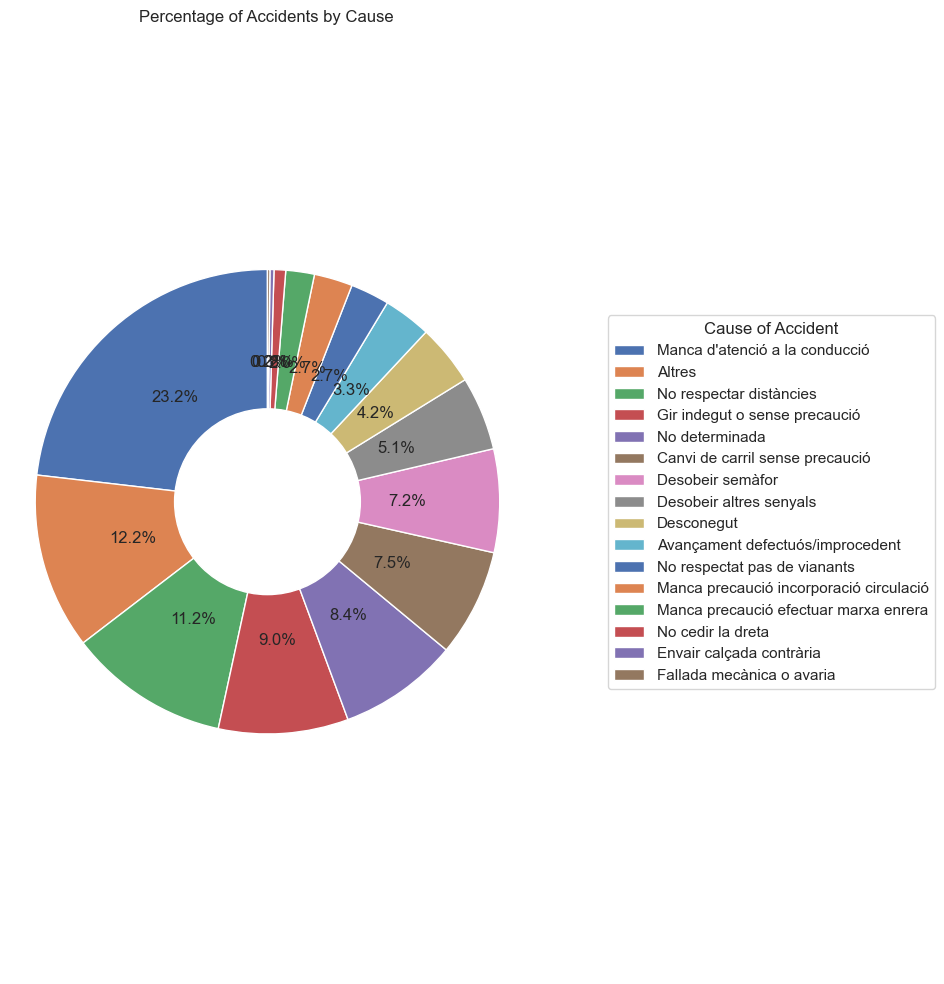

In [281]:
# Group by cause to get counts
cause_counts = data['Descripcio_causa_mediata'].value_counts()

# Calculate the percentage of each cause
cause_percentages = cause_counts / cause_counts.sum() * 100

# Create a donut chart
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the pie chart with only percentages displayed
wedges, texts, autotexts = ax.pie(cause_percentages, 
                                   labels=None,  # No labels for the causes
                                   autopct='%1.1f%%',  # Display percentages only
                                   startangle=90)

# Draw a circle at the center of the pie to make it a donut chart
centre_circle = plt.Circle((0, 0), 0.40, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Equal aspect ratio ensures that pie is drawn as a circle
ax.axis('equal')  

# Set title
plt.title('Percentage of Accidents by Cause')

# Move the legend outside of the plot area, aligned horizontally to the right
plt.legend(wedges, cause_percentages.index, title='Cause of Accident', bbox_to_anchor=(1.15, 0.5), loc='center left')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()


* Tenemos una causa mayoritaria, que es la falta de atención
* la mayor causa de accidentes es falta de atención, "otras", el giro indebido o sin precaución y el no respetar las distancas (entendemos que entre vehículos, puesto que con los peatones hay una categoría a parte). 
* Vemos que hay dos causas que parecen decir lo mismo, que son : "Altres" y "Desconegut", es decir, otras causas no mencionadas (podría ser el alcohol una de ellas ?) y causas desconocidas

**¿En qué franjas horarias hay más y menos accidentes?**

Para crear un gráfico de barras que desglosa cada turno (Matí, Tarda, Nit) en las horas individuales que cubre, primero necesitamos asociar las horas en el conjunto de datos a los turnos correspondientes. Luego, representaremos el total de accidentes por hora para cada turno usando diferentes colores para distinguir entre turnos.

Asignación de Turnos y Horas:

- Mañana (Matí): 6 AM - 2 PM (Horas 6-13)
- Tarde (Tarda): 2 PM - 10 PM (Horas 14-21)
- Noche (Nit): 10 PM - 6 AM (Horas 22-5)

Para ello asociamos cada hora en el conjunto de datos a su respectivo turno, agrupar los datos por hora y turno para obtener el conteo total de accidentes por hora dentro de cada turno y representar los resultados coloreando cada barra según el turno yn en orden cronológico (si no, suele ser alfabético).

In [411]:
# Assign colors to shifts
shift_colors = {
    'Matí': '#5b9bd5',    # Grey-blue for Morning (6 AM - 1 PM)
    'Tarda': 'darkgreen',  # Dark green for Afternoon (2 PM - 9 PM)
    'Nit': 'darkorange'    # Dark orange for Night (10 PM - 5 AM)
}

# Define the logical order for the shifts (Morning, Afternoon, Night)
shift_order = ['Matí', 'Tarda', 'Nit']

# Group by shift to get total counts per shift
shift_counts = data.groupby('Descripcio_torn').size().reset_index(name='Count')

# Reorder the shift counts based on the defined shift_order
shift_counts['Descripcio_torn'] = pd.Categorical(shift_counts['Descripcio_torn'], categories=shift_order, ordered=True)
shift_counts = shift_counts.sort_values('Descripcio_torn')

# Print the total counts per shift for verification
shift_counts


,Descripcio_torn,Count
0,Matí,3302
2,Tarda,4491
1,Nit,1104


De los 8897 accidentes encontrados, consta que aproximadamente la mitad (4491) se producen por la tarde, algo más de un tercio (3302) ocurren por la mañana y 1104 por la noche.

**Causas de los accidentes por franjas horarias**

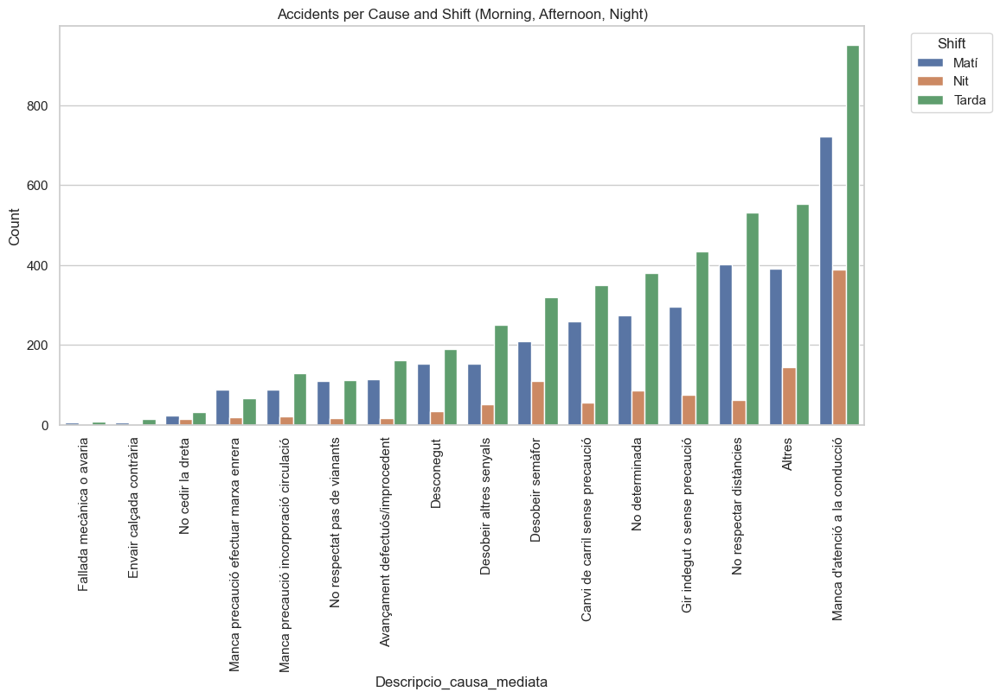

In [283]:
# Group by cause and shift to get counts
cause_shift_counts = data.groupby(['Descripcio_causa_mediata', 'Descripcio_torn']).size().reset_index(name='Count')

# Aggregate counts by cause to determine the ordering
cause_order = cause_shift_counts.groupby('Descripcio_causa_mediata')['Count'].sum().sort_values().index.tolist()

# Plotting with seaborn
plt.figure(figsize=(12, 6))
sns.barplot(data=cause_shift_counts, x='Descripcio_causa_mediata', y='Count', hue='Descripcio_torn', order=cause_order)
plt.title('Accidents per Cause and Shift (Morning, Afternoon, Night)')
plt.xticks(rotation=90)
plt.legend(title='Shift', bbox_to_anchor=(1.05, 1), loc='upper left')  # Optional: Move legend outside
plt.show()


Vemos que en turno en que hay más accidentes es por la tarde, sin embargo, las principales causas son las mismas : 

- falta de atención 
- giro indebido o sin precaución 
- "otras"
- en horario noctirno, a parte de la falta de atención, una causa importante es saltarse el semáforo, mientras que de día esto viene en sexta posición


**¿Ocurren en los mismos lugares en todas las franjas horarias?**

* Visualizamos 3 Mapas de todos los accidentes ocurridos:

   - en azul, los de por la mañana, entre las 6 y las 13 horas
   - en verde, los que ocurrieron por la tarde de 14 a 21 horas
   - en naranja, los accidentes nocturnos, de 22 horas hasta las 5 de la mañana 

In [409]:
import folium
from IPython.display import display

# Define la función para asignar turnos basados en la hora
def assign_shift(hour):
    if 6 <= hour <= 13:
        return 'Matí'   # Mañana
    elif 14 <= hour <= 21:
        return 'Tarda'  # Tarde
    else:
        return 'Nit'    # Noche

# Crea una nueva columna en el DataFrame para turnos según la hora
data['Shift'] = data['Hora_dia'].apply(assign_shift)

# Crea un mapeo de colores según los turnos
shift_colors = {
    'Matí': '#5b9bd5',    # Gris-azul para Mañana
    'Tarda': 'darkgreen',  # Verde oscuro para Tarde
    'Nit': 'darkorange'    # Naranja oscuro para Noche
}

# Crea un mapa combinado para Matí y Tarda
barcelona_map_combined = folium.Map(location=[41.3851, 2.1734], zoom_start=13, tiles='OpenStreetMap')
folium.TileLayer(
    tiles='cartodb positron',  # Fondo más claro para Matí y Tarda
    name='Lighter Background',
    control=False
).add_to(barcelona_map_combined)

# Agrega accidentes de Matí y Tarda al mapa combinado
for _, row in data.iterrows():
    if row['Shift'] in ['Matí', 'Tarda']:
        folium.CircleMarker(
            location=(row['Latitud_WGS84'], row['Longitud_WGS84']),
            radius=1.5,  # Radio aumentado para mejor visibilidad
            color=shift_colors[row['Shift']],
            fill=True,
            fill_opacity=0.6,
            popup=f'Expedient: {row["Numero_expedient"]}<br>Shift: {row["Shift"]}'
        ).add_to(barcelona_map_combined)

# Muestra el mapa combinado de Matí y Tarda
display(barcelona_map_combined)

# Crea un mapa para solo la Noche
barcelona_map_nit = folium.Map(location=[41.3851, 2.1734], zoom_start=13, tiles='OpenStreetMap')
folium.TileLayer(
    tiles='cartodb dark_matter',  # Fondo oscuro para Noche
    name='Dark Background',
    control=False
).add_to(barcelona_map_nit)

# Agrega accidentes de Nit al mapa nocturno
for _, row in data.iterrows():
    if row['Shift'] == 'Nit':
        folium.CircleMarker(
            location=(row['Latitud_WGS84'], row['Longitud_WGS84']),
            radius=1.5,  # Radio aumentado para mejor visibilidad
            color=shift_colors['Nit'],
            fill=True,
            fill_opacity=0.6,
            popup=f'Expedient: {row["Numero_expedient"]}<br>Shift: Nit'
        ).add_to(barcelona_map_nit)

# Muestra el mapa nocturno
display(barcelona_map_nit)


**De los tres mapas de turnos horarios que acabamos de ver, resaltan las siguentes observaciones**:
    
* en horarios **diurnos**, los mapas de la mañana y tarde se parecen mucho, excepto entorno al **Nus de la Trinitat**, donde se unen la Ronda de Dalt con la del Litoral y que es más peligroso por las mañanas, mientras que la **Ronda Litoral a alturas de Montjuïc y Zona Franca**, que coge protagonismo en horarios de mediodía / tarde.
* en el mediodía / tarde, los ejes **Ronda de Dalt, Gran Via de les Cortes Catalanes, Aragó, la parte más alta (nordoeste) de la Diagonal, Paral·lel, General Mitre, Carretera de Sants y la Ronda Litoral en Vila Olimpica / Poblenou** tienen muchos más accidentes que el resto.
* En horario **nocturno** disminuyen los accidentes en zona alta como en la Ronda de alt y se concentran en el centro, cerca de los lugares de comida y ocio, en el Eixample entre Gran Via y Diagonal y cerca del mar en la Ronda Litoral entorno a Barceloneta, Vila Olimpica y Poblenou. 
* en las **tres franjas horarias** el **Eixample** y el **Front Marítim (Ronda Litoral en su parte subterránea)** destacan por su cantidad y densidas de accidentes, siendo las horas de queadas, salidas a cenar, a los bares y vueltas a casa, posiblemente relajados e incluso habiéndose tomado una copa.

A continuación observaremos el número total de **accidentes que ocurrieron por cada hora del día**, resaltando con sus respectivos colores, las tres grandes franjsas horarias del día, también llamadas turnos. * Veamos un resumen numérico de lo que acabamos de ver, es decir, el número total de accidentes que ocurrieron por las tres principales franjsas horarias.

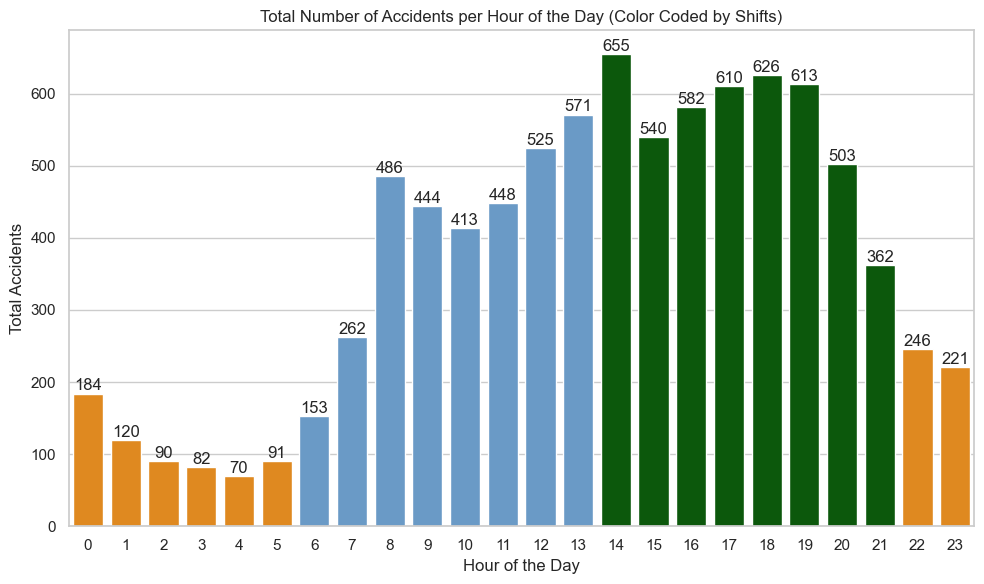

In [285]:
# Assign colors to shifts
shift_colors = {
    'Matí': '#5b9bd5',    # Grey-blue for 6 AM - 1 PM
    'Tarda': 'darkgreen',  # Dark green for 2 PM - 9 PM
    'Nit': 'darkorange'    # Dark orange for 10 PM - 5 AM
}

# Function to assign shifts based on the hour of the day
def assign_shift(hour):
    if 6 <= hour <= 13:
        return 'Matí'
    elif 14 <= hour <= 21:
        return 'Tarda'
    else:
        return 'Nit'

# Apply the assign_shift function to assign shifts based on the 'Hora_dia' column
data['Shift'] = data['Hora_dia'].apply(assign_shift)

# Calculate the total number of accidents by hour of the day
total_accidents_by_hour = data.groupby('Hora_dia')['Numero_expedient'].count()

# Create a list of bar colors based on the assigned shift for each hour
bar_colors = total_accidents_by_hour.index.map(lambda hour: shift_colors[assign_shift(hour)])

# Plotting the total accidents per hour with color-coded bars by shifts
plt.figure(figsize=(10, 6))

# Create the bar plot with the correct bar colors
sns.barplot(x=total_accidents_by_hour.index, y=total_accidents_by_hour.values, palette=bar_colors)

# Add title and labels
plt.title('Total Number of Accidents per Hour of the Day (Color Coded by Shifts)')
plt.xlabel('Hour of the Day')
plt.ylabel('Total Accidents')

# Annotate each bar with the total number of accidents
for i, count in enumerate(total_accidents_by_hour.values):
    plt.text(i, count + 0.1, str(count), ha='center', va='bottom')

# Display the plot
plt.tight_layout()
plt.show()


**Group by Descripcio_causa_mediata and Descripcio_torn:**

get the total count of accidents per shift (Matí, Tarda, Nit) across all causes, you should group the data only by Descripcio_torn (the shift),

**La franja horaria** en la que hay más accidentes es por la tarde, seguido de la mañana y por último, por la noche. 

Esto tiene su lógica en que hay muchos más vehículos y también peatones circulando de día que de noche.

**Las horas con más accidentes** han sido las que corresponden con las entradas y salidas del trabajo, siendo durante los despazamientos (en orden ascendente):

    - de 8 a 9 de la mañana
    - de 4 a 8 de la tarde
    - de 12 y hasta las 15h de la tarde, particularmente entorno a las 14h (14:00 a 14:59).

Interpretación del gráfico:

    Se puede pensar que los accidentes al mediodía son fruto de las prisas por ir a comer, el hambre, o haber quedado con alguien

    Del hecho que en esas horas coinciden personas que comen más pronto y otras más tarde, algunas incluso pudiendo haber consumido algo de alcohol mientras almorzaron o comieron, con el efecto retardado que tienen las bebidas más comunes como cerveza, vino, carajillos (cafés con whisky), etc.. 

    Coinciden también el final de los turnos de la mañana, con el principio de los trabajores que obran por la tarde y al mismo tiempo, siguen estando presentes en la ciudad los trabajadores con horarios de oficina estándar.

**Accidentes por media diaria**

Este gráfico representa el cálculo medio diario de lo anterior y está aquí para visualizar y comparar mejor lo que significan los grandes números del dataset para un conductor o un paseante en diferentes destinos dentro de la ciudad. Así, alguien que vive y trabaja en el Eixample se expone más y podría ser testigo de entre 6 y 7 accidentes diarios (en 24 horas), mientras que los demás estarán en calles 2 a 4 veces más "tranquilas". Como corazón de la ciudad, de la economía y siendo districto más dinámico, también tiene esta disventaja, que además viene con mucho ruido. 

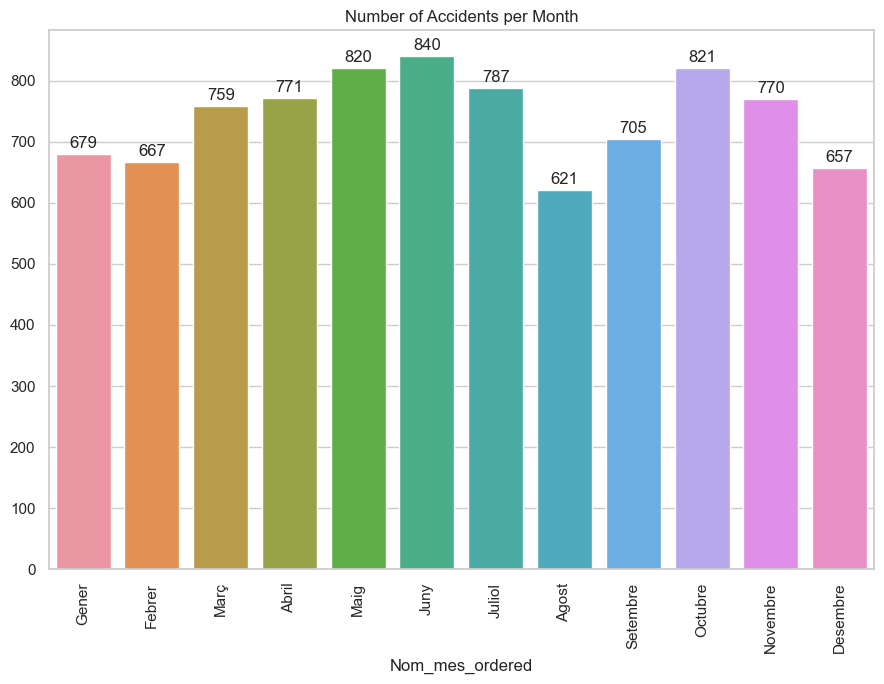

In [286]:

# Create a dictionary to map the 'Mes_any' column to the corresponding 'Nom_mes'
month_mapping = {
    1: 'Gener', 2: 'Febrer', 3: 'Març', 4: 'Abril', 5: 'Maig', 6: 'Juny',
    7: 'Juliol', 8: 'Agost', 9: 'Setembre', 10: 'Octubre', 11: 'Novembre', 12: 'Desembre'
}

# Add a new column to the dataset with the ordered month names
data['Nom_mes_ordered'] = data['Mes_any'].map(month_mapping)

# Group the data by the ordered month and count the number of accidents
accidents_by_month = data['Nom_mes_ordered'].value_counts().reindex(list(month_mapping.values()))

# Plot the data in order of months
plt.figure(figsize=(9,7))
sns.barplot(x=accidents_by_month.index, y=accidents_by_month.values)

# Rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

# Add title
plt.title('Number of Accidents per Month')

# Annotate each bar with the number of accidents
for i, count in enumerate(accidents_by_month.values):
    plt.text(i, count + 5, str(count), ha='center', va='bottom')

# Display the plot
plt.tight_layout()
plt.show()


En este gráfico se ve con bastante claridad la influencia de las vacaciones en la ciudad, con agosto y diciembre con tendencias a  la baja hasta que vuelve el buen tiempo en primavera, época en la que más aumentan los accidentes.

Con el "mal tiempo" ni los conductores ni otros usuarios de la vía pública se arriesgan tanto.

**Media de accidentes en la ciudad por cada dia de la semana**

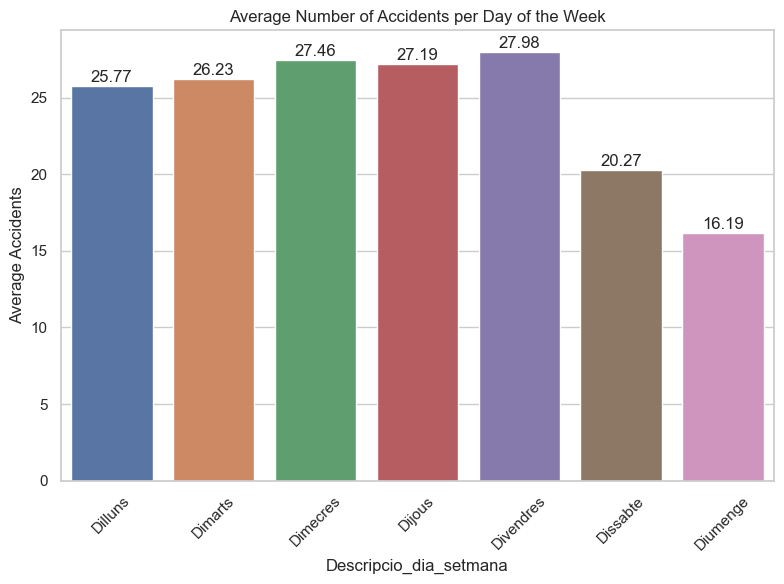

In [287]:
import seaborn as sns
import matplotlib.pyplot as plt

# Mapping for days of the week in Catalan
day_mapping = {
    'Dilluns': 1, 'Dimarts': 2, 'Dimecres': 3, 'Dijous': 4, 
    'Divendres': 5, 'Dissabte': 6, 'Diumenge': 7
}

# Create a new column that maps the day of the week to numbers
data['Day_number'] = data['Descripcio_dia_setmana'].map(day_mapping)

# Group the data by 'Descripcio_dia_setmana' and calculate the mean accidents
accidents_by_day = data.groupby('Descripcio_dia_setmana').size().reindex(list(day_mapping.keys()))
mean_accidents_by_day = accidents_by_day / 52  # Assuming there are 52 weeks in a year

# Create a plot for mean accidents per day of the week
plt.figure(figsize=(8, 6))
sns.barplot(x=mean_accidents_by_day.index, y=mean_accidents_by_day.values)
plt.title('Average Number of Accidents per Day of the Week')
plt.ylabel('Average Accidents')

# Annotate each bar with the average number of accidents
for i, count in enumerate(mean_accidents_by_day.values):
    plt.text(i, count + 0.05, f'{count:.2f}', ha='center', va='bottom')

# Rotate x-ticks on the day names
plt.xticks(rotation=45)

# Adjust layout
plt.tight_layout()

# Display the plot
plt.show()


En este último gráfico es interesante obserrvar que los fines de semana los accidentes bajan considerablemente en la media de Barcelona, sobretodo los domingos. 

- Esto puede explicarse en gran parte por la casi ausencia de trabajadores en las oficinas y en los comercios, quedando básicamente los que trabajan en restauración, transporte público y ocio.

- También en cuando baja drásticamente la actividad en general y en particular el estrés de los colegios y universidades, los trabajadores de la contrucción, camioneros y conductores de furgonetas.

**Distribución de accidentes por cada districto**:

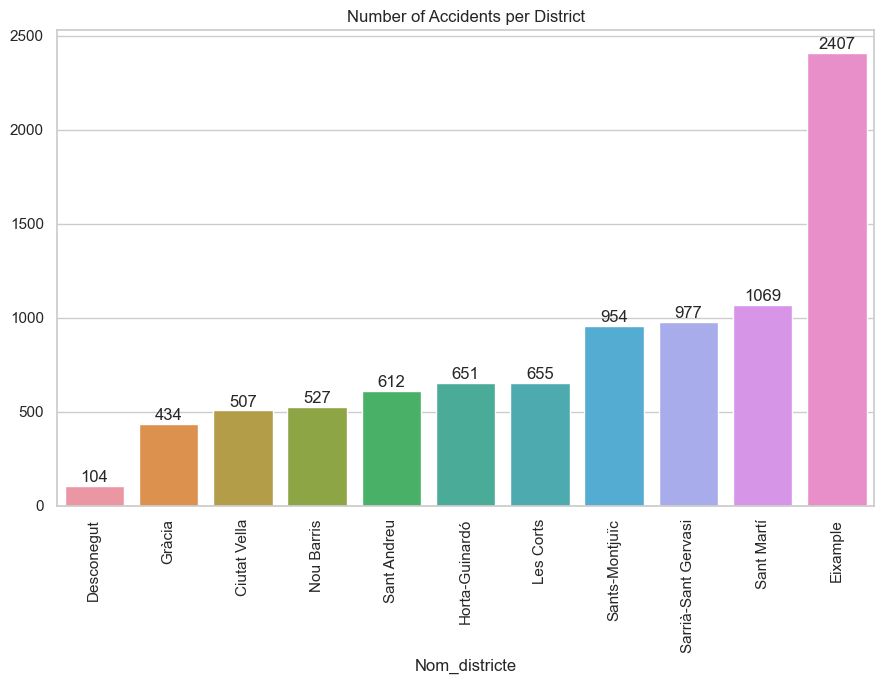

In [288]:

# Count the accidents per district and sort in ascending order
accidents_by_district = data['Nom_districte'].value_counts(ascending=True)

# Create a sorted bar plot
plt.figure(figsize=(9,7))
sns.barplot(x=accidents_by_district.index, y=accidents_by_district.values)

# Rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

# Add title
plt.title('Number of Accidents per District')

# Annotate each bar with the number of accidents
for i, count in enumerate(accidents_by_district.values):
    plt.text(i, count + 5, str(count), ha='center', va='bottom')

# Display the plot
plt.tight_layout()
plt.show()


**Accidentes en números totales anuales**

* Vemos como el Eixample es de lejos el districto con mayor número de accidentes, siendo nominalmente el doble que Sant Martí. 

* Si recordamos los mapas, esto se debe a que tiene muchas gramdes artérias y calles anchas onde pasan muchas personas para ir a trabajar, ir de tendas o a comer; allí pasan buses, motos y coches, turistas y estudiantes.
* Sant Martí tienen como eje principal conflictivo la Ronda Litoral a la altura de Poblenou, aunque está semi subterrado y no convive mucho con los peatones; también tiene la Gran Via a la altura de Glèries y el Clot, con mucha afluencia. 
* La Gran Via la comparte también Sants-Montjuïc, donde Paral·lel es otra avenida con muchos accidentes.
* En el top-4 tenemos también a Sarrià-Sant Gervasi, por tener avenidas como Diagonal o la Ronda de Dalt.

* Los lugares que aparecen como desconocidos probablemente son de parques, caminos de tierra y zonas verdes como Collserola, Valvidrera o de lugares limítrofes entre dos barrios o districtos, incluso porían ser de los túneles y que el agente no haya sabido exactamente donde está, o que sea fruto de errores, prisas o desconocimiento. 



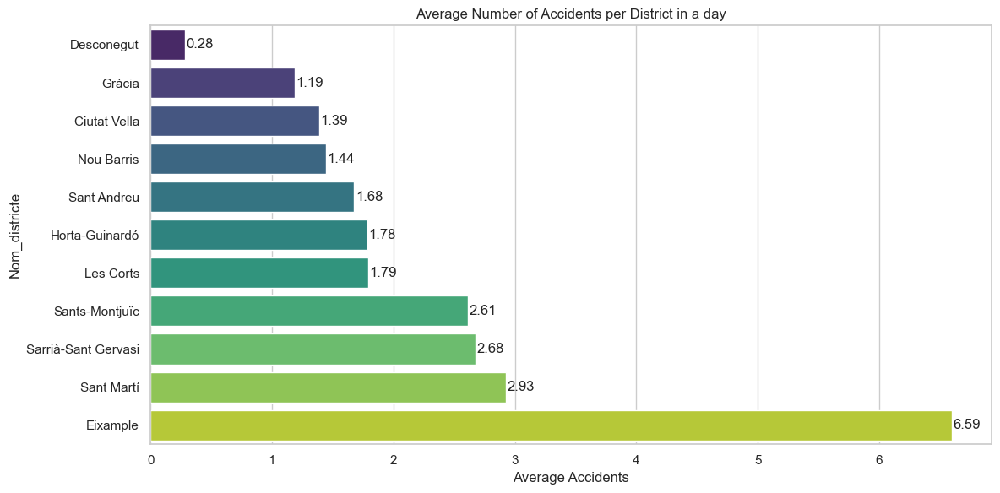

In [289]:
# Group the data by 'Nom_districte' and calculate the total number of accidents
accidents_by_district = data['Nom_districte'].value_counts().reset_index(name='Count')
accidents_by_district.columns = ['Nom_districte', 'Total_Accidents']

# Calculate the average accidents per district (assuming the data covers a year)
accidents_by_district['Average'] = accidents_by_district['Total_Accidents'] / 365  # Assuming data is daily

# Sort the results from least to most accidents
accidents_by_district = accidents_by_district.sort_values(by='Average')

# Create a plot for average accidents per district
plt.figure(figsize=(12, 6))
sns.barplot(x='Average', y='Nom_districte', data=accidents_by_district, palette='viridis')
plt.title('Average Number of Accidents per District in a day')
plt.xlabel('Average Accidents')

# Annotate each bar with the average number of accidents
for index, value in enumerate(accidents_by_district['Average']):
    plt.text(value + 0.01, index, f'{value:.2f}', va='center')

# Adjust layout
plt.tight_layout()

# Display the plot
plt.show()


**Media diaria por districtos**

Este gráfico representa el cálculo medio diario de lo anterior y está aquí para visualizar y comparar mejor lo que significan los grandes números del dataset para un conductor o un paseante en diferentes destinos dentro de la ciudad. Así, alguien que vive y trabaja en el Eixample se expone más y podría ser testigo de entre 6 y 7 accidentes diarios (en 24 horas), mientras que los demás estarán en calles 2 a 4 veces más "tranquilas". Como corazón de la ciudad, de la economía y siendo districto más dinámico, también tiene esta disventaja, que además viene con mucho ruido. 

------------------------------------------

* **Correlaciones**: nos tendrían que dar el nivel de relación entre las iferentes variiables numéricas

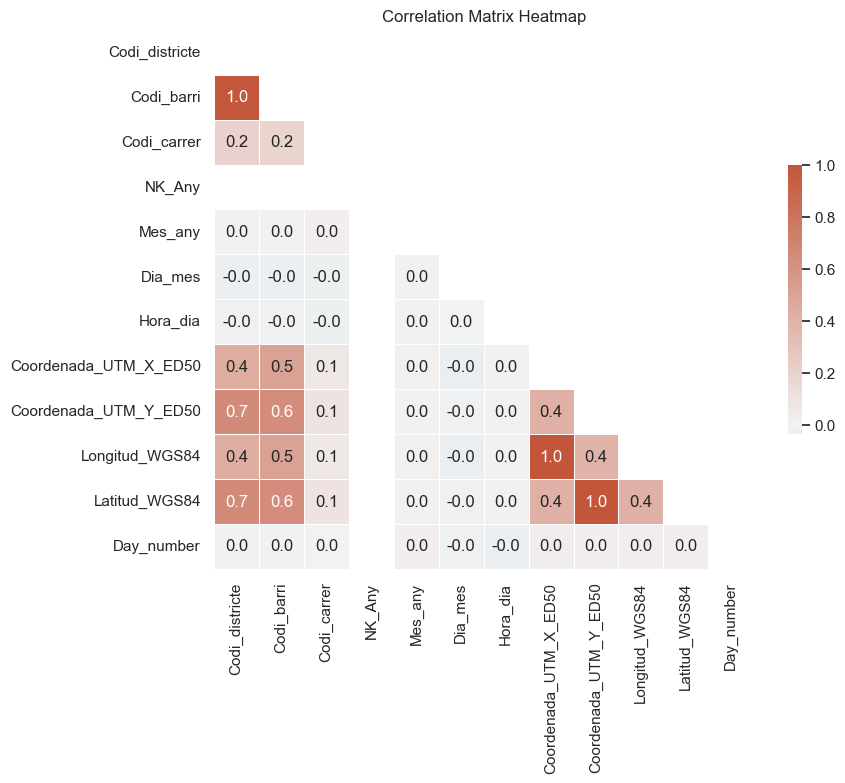

In [290]:
### ver correlaciones

# Select only numeric columns from your data
numeric_data = data.select_dtypes(include=[np.number])

# Calculate the correlation matrix
corr = numeric_data.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
fig, ax = plt.subplots(figsize=(9, 7))  # Adjust size as needed

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.1f')

plt.title('Correlation Matrix Heatmap')
plt.show()


In [291]:
corr.round(3)

,Codi_districte,Codi_barri,Codi_carrer,NK_Any,Mes_any,Dia_mes,Hora_dia,Coordenada_UTM_X_ED50,Coordenada_UTM_Y_ED50,Longitud_WGS84,Latitud_WGS84,Day_number
Codi_districte,1.000,0.986,0.203,NaN,0.007,-0.028,-0.009,0.441,0.651,0.435,0.652,0.008
Codi_barri,0.986,1.000,0.194,NaN,0.008,-0.029,-0.006,0.505,0.633,0.500,0.635,0.009
Codi_carrer,0.203,0.194,1.000,NaN,0.019,-0.016,-0.021,0.063,0.094,0.063,0.094,0.001
NK_Any,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Mes_any,0.007,0.008,0.019,NaN,1.000,0.009,0.005,0.018,0.005,0.018,0.005,0.025
Dia_mes,-0.028,-0.029,-0.016,NaN,0.009,1.000,0.001,-0.034,-0.011,-0.034,-0.011,-0.013
Hora_dia,-0.009,-0.006,-0.021,NaN,0.005,0.001,1.000,0.005,0.009,0.005,0.009,-0.025
Coordenada_UTM_X_ED50,0.441,0.505,0.063,NaN,0.018,-0.034,0.005,1.000,0.415,1.000,0.421,0.034
Coordenada_UTM_Y_ED50,0.651,0.633,0.094,NaN,0.005,-0.011,0.009,0.415,1.000,0.405,1.000,0.022
Longitud_WGS84,0.435,0.500,0.063,NaN,0.018,-0.034,0.005,1.000,0.405,1.000,0.412,0.034


Tal como está el conjunto de datos original, no podemos sacar conclusiones relevantes sobre las **correlaciones entre variables**, porque solamente se correlacionan las cuatro variables de **ubicación geográfica** entre sí y éstas coordenadas con 'Codi_districte y Codi_barri. En cambio, 'Codi_carrer' está poco o nada relacionado y debe ser porque las calles son muy largas y sus coordenadas varían mucho de un lugar al otro de la ciudad.


-----------------

## **Verificación y limpieza (transformacion de datos)**

En esta parte de manejo y transformación de datos, se han de tomar varias decisiones que afectarán al dataset y al trabajo que se puede hacer con diversos modelos estadísticos y de machine learning. Muchas decisiones tienen que ver con :

- mantener o no ciertas columnas, valorando qué aportan y si no, por qué se puede prescindir de ellas. En caso de quedarse con ellas, 
- valorar si se quedan tal cual o si se han de transformar (cambiar de tipo de dato, escalar, generar dummies, etc)
- qué se busca comprobar con el dataset a nivel de aprendisaje automático y si se tienen las columnas target necesarias ; en caso de no tenerlas explicitamente, decidir si formarlas mediante cálculos y más manipulacion de datos, o si probar un algoritmo de aprendisaje no supervisado, una serie temporal, etc.

**Verificiones y correcciones antes de ir más adelante**

Queremos obtener una visión clara de qué columnas pueden tener valores repetidos o duplicados en data, aunque los nombres sean diferentes. Es importante verificar como ha podido cambiar nuestro dataset y ajustamos / limpiamos antes de ir más adelante con las transformacoiones más complejas y así evitar errores y complicaciones de cara al machine learning.

Identificar columnas en tu DataFrame data cuyos datos sean duplicados o muy similares, aunque el nombre de las columnas sea diferente, puedes utilizar la correlación entre las columnas, o directamente comparar las filas. Aquí te dejo un enfoque basado en correlación y en comparación exacta para columnas duplicadas:

Usar correlación para detectar columnas con valores similares: esto ayudará a encontrar columnas que tengan una relación muy alta (cercana a 1) en términos de sus valores.

Detectar columnas que tengan exactamente los mismos valores: encontrar duplicados exactos aunque los nombres de las columnas sean diferentes.

In [292]:
# Transponer el DataFrame para poder comparar columnas fácilmente
data_T = data.T

# Encontrar las columnas con datos exactamente iguales
duplicated_columns = data_T.duplicated()

# Mostrar las columnas duplicadas
duplicated_columns[duplicated_columns].index.tolist()


['Shift', 'Nom_mes_ordered']

Comparar las columnas con sus valores (por fila) para ver si alguna es un duplicado exacto de otra.

In [293]:
# Comparar todas las columnas entre sí
duplicate_columns = []
for col1 in data.columns:
    for col2 in data.columns:
        if col1 != col2 and data[col1].equals(data[col2]):
            duplicate_columns.append((col1, col2))

# Mostrar las columnas que tienen valores idénticos
duplicate_columns


[('Nom_mes', 'Nom_mes_ordered'),
 ('Descripcio_torn', 'Shift'),
 ('Shift', 'Descripcio_torn'),
 ('Nom_mes_ordered', 'Nom_mes')]

In [294]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Numero_expedient          8897 non-null   object 
 1   Codi_districte            8897 non-null   int64  
 2   Nom_districte             8897 non-null   object 
 3   Codi_barri                8897 non-null   int64  
 4   Nom_barri                 8897 non-null   object 
 5   Codi_carrer               8897 non-null   int64  
 6   Nom_carrer                8897 non-null   object 
 7   Num_postal                8893 non-null   object 
 8   Descripcio_dia_setmana    8897 non-null   object 
 9   NK_Any                    8897 non-null   int64  
 10  Mes_any                   8897 non-null   int64  
 11  Nom_mes                   8897 non-null   object 
 12  Dia_mes                   8897 non-null   int64  
 13  Hora_dia                  8897 non-null   int64  
 14  Descripc

- Tenemos 23 columnas en este momento. 
- Buscamos mantener las columnas 'Descripcio_torn' y 'Nom_mes' y eliminar las duplicadas ('Shift' y 'Nom_mes_ordered') de la siguiente manera:

In [295]:
# Eliminar las columnas que hemos visto tienen datos idénticos y mantener una de las dos
data = data.drop(columns=['Shift', 'Nom_mes_ordered'])

# Verificar que se eliminaron correctamente
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Numero_expedient          8897 non-null   object 
 1   Codi_districte            8897 non-null   int64  
 2   Nom_districte             8897 non-null   object 
 3   Codi_barri                8897 non-null   int64  
 4   Nom_barri                 8897 non-null   object 
 5   Codi_carrer               8897 non-null   int64  
 6   Nom_carrer                8897 non-null   object 
 7   Num_postal                8893 non-null   object 
 8   Descripcio_dia_setmana    8897 non-null   object 
 9   NK_Any                    8897 non-null   int64  
 10  Mes_any                   8897 non-null   int64  
 11  Nom_mes                   8897 non-null   object 
 12  Dia_mes                   8897 non-null   int64  
 13  Hora_dia                  8897 non-null   int64  
 14  Descripc

Quedan 21 columnas y seguimos comprobando datos específicos de otras columnas. Algunas generan dudas.

In [296]:
# List of columns to check
columns_to_check = ['Hora_dia', 'Day_number', 'Dia_mes', 'Mes_any', 'Codi_districte', 'Nom_districte', 'Codi_barri']#, 'Num_postal','Codi_carrer']

# Loop through the list of columns and print unique values in ascending order
for column in columns_to_check:
    unique_values = sorted(data[column].unique())
    print(f"Unique values for '{column}':")
    print(unique_values)
    print("\n")  # Adding a blank line for better readability


Unique values for 'Hora_dia':
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]


Unique values for 'Day_number':
[1, 2, 3, 4, 5, 6, 7]


Unique values for 'Dia_mes':
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31]


Unique values for 'Mes_any':
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]


Unique values for 'Codi_districte':
[-1, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]


Unique values for 'Nom_districte':
['Ciutat Vella', 'Desconegut', 'Eixample', 'Gràcia', 'Horta-Guinardó', 'Les Corts', 'Nou Barris', 'Sant Andreu', 'Sant Martí', 'Sants-Montjuïc', 'Sarrià-Sant Gervasi']


Unique values for 'Codi_barri':
[-1, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73]




* Las horas están bien y aparecen todas (lo que quiere decir que hubo accidentes en todas las horas horas posibles)

* El nombre del día es confuso pero se ha comprobado que se trata de días de la semana y no de meses. Luego se va a cambiar el nombre de la columna de 'Day_number' a 'Dia_semana'.

* 'Mes_any' tiene los números correspondientes a los meses

* La variable código de calle tiene un valor faltante (-1) y los demás son números desde pequeños hasta 6 cifras.

* **'Codi_carrer', 'Codi_barri', 'Codi_districte'** tienen los códigos de los barrios y districtos y además, algunos son desconocidos (imputados expresamente como **-1**), pero sí se tiene siempre la geolocalización, por lo que intentaremos usar estos datso para encontrar el código de districto y de barrio correctos.

* Otra opción es que que no se utilicen estas columnas en las predicciones, sino que se usen solo las coordenadas GPS. Esto en cambio podría quizás dificultar el posterior análisis de los resultados.

In [297]:
print(data['Codi_carrer'].unique())

[    -1 209900 226400 ... 331700 128208 108903]


Haremos una función para volver a mirar donde más tenemos valores puestos como **'Desconegut'**, o desconocidos, como en el caso de **'Nom_districte'** y se interpretará el significado y valorará qué métodos (geolocalización o cálculos) nos pueden dar el valor correcto; en caso contrario, mantener o quitar las filas o columnas relacionadas con estos datos.

In [298]:
# Verificar números postales
print(data['Num_postal'].unique())

['0         ' '11        ' '120       ' ... '0100 0104' '0041B0041B'
 '0355 0357']


Los números de puerta están como objetos o direcciones postales pueden llegar a ser problemáticos si se quisiera utilizar para alguna aplicación o para análisis profundo. De otra manera, puede ser que no sea una columna importante a mantener según lo que se desea hacer más tarde.
Se intentará rellenar los datos faltantes por las coordenadas GPS o por aproximación respeto a otros puntos cercanos.

In [299]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Numero_expedient          8897 non-null   object 
 1   Codi_districte            8897 non-null   int64  
 2   Nom_districte             8897 non-null   object 
 3   Codi_barri                8897 non-null   int64  
 4   Nom_barri                 8897 non-null   object 
 5   Codi_carrer               8897 non-null   int64  
 6   Nom_carrer                8897 non-null   object 
 7   Num_postal                8893 non-null   object 
 8   Descripcio_dia_setmana    8897 non-null   object 
 9   NK_Any                    8897 non-null   int64  
 10  Mes_any                   8897 non-null   int64  
 11  Nom_mes                   8897 non-null   object 
 12  Dia_mes                   8897 non-null   int64  
 13  Hora_dia                  8897 non-null   int64  
 14  Descripc

In [300]:
import pandas as pd

# Step 1: Check for NaN or null values in the dataset
missing_data = data.isna() | data.isnull()

# Step 2: Get a summary of missing values by column and filter only columns with missing data
missing_summary = missing_data.sum(axis=0)
missing_summary = missing_summary[missing_summary > 0]  # Show only columns with missing values

# Step 3: Get the total number of rows with at least one missing value
rows_with_missing = missing_data.any(axis=1).sum()

# Step 4: Print the results
print(f"Missing values by column (only showing those with missing data):\n{missing_summary}")
print(f"Total number of rows with missing values: {rows_with_missing}")

# Optional: If you want to see which rows contain missing values, you can print the relevant part of the dataset
missing_rows = data[missing_data.any(axis=1)]
missing_rows.head()  # You can increase the number of rows displayed



Missing values by column (only showing those with missing data):
Num_postal    4
dtype: int64
Total number of rows with missing values: 4


,Numero_expedient,Codi_districte,Nom_districte,Codi_barri,Nom_barri,Codi_carrer,Nom_carrer,Num_postal,Descripcio_dia_setmana,NK_Any,...,Nom_mes,Dia_mes,Hora_dia,Descripcio_torn,Descripcio_causa_mediata,Coordenada_UTM_X_ED50,Coordenada_UTM_Y_ED50,Longitud_WGS84,Latitud_WGS84,Day_number
4,2023S006486,-1,Desconegut,-1,Desconegut,-1,Augusta / Hort de la Vila ...,NaN,Dijous,2023,...,Novembre,2,14,Tarda,Desobeir semàfor,426883.33,4583690.92,2.124189,41.399587,4
6,2023S002864,-1,Desconegut,-1,Desconegut,-1,Lisboa / Puríssima ...,NaN,Dissabte,2023,...,Maig,13,18,Tarda,Desobeir altres senyals,429178.93,4586631.06,2.151304,41.426273,6
8,2023S001077,-1,Desconegut,-1,Desconegut,-1,Carrasco i Formiguera / Dolors Monserdà ...,NaN,Dimecres,2023,...,Febrer,22,21,Tarda,Desobeir altres senyals,426738.14,4583956.28,2.122420,41.401964,3
10,2023S004509,-1,Desconegut,-1,Desconegut,-1,Dolors Monserdà / Carrasco i Formiguera ...,NaN,Dimarts,2023,...,Juliol,25,20,Tarda,Desobeir altres senyals,426738.14,4583956.28,2.122420,41.401964,2


Falta número postal y datos de barrio y districto en 4 accidentes que han tenido lugar en una intersecciones. Estas calles se pueden consultar en el mapa y son en la parte noroeste de la ciudad

----------------------------------

### **Transformaciones sobre columnas**

**'Num_postal: Decisión de mantener (y por lo tanto, arreglar) esta variable o eliminarla'** 

Se puede mantener la columna 'Num_postal' si creemos que será útil para predicciones basadas en input manual (por ejemplo, en una aplicación onde al imputar una dirección, nos daría las probabilidades de sufrir o presenciar un accidente). Sin embargo, si decidimos que las coordenadas geográficas (Latitud y Longitud) son suficientes y queremos evitar redundancias, se pueden eliminar 'Num_postal' y trabajar solo con los datos geográficos.

- Eliminar letras: Si hay letras en los valores como en '0041B0041B', las quitamos.
- Tratar rangos: Si el valor es un rango (como "0100 0104"), solo mantenemos el primer número.
- Mantener valores cortos: Dejamos los valores con 1 a 3 dígitos tal como están.
- Decisión final: Si usar 'Num_postal' o eliminarla para evitar redundancias.
- Control de valores nulos: La línea if pd.isna(value): return np.nan maneja los valores NaN para que no se procesen.
- Convertir a cadena: Convertimos cada valor a cadena con str(value) antes de aplicar las expresiones regulares.
- Filtrar valores faltantes: Al final, eliminamos las filas con valores faltantes en 'Num_postal' con dropna().

In [301]:
import re
import numpy as np
from sklearn.neighbors import KNeighborsRegressor

# Step 1: Define a function to clean 'Num_postal'
def clean_num_postal(value):
    if pd.isna(value):
        return np.nan
    
    # Convert to string if not already
    value = str(value)
    
    # Remove any letters
    value = re.sub(r'[A-Za-z]', '', value).strip()
    
    # If space exists, take the first part
    if ' ' in value:
        value = value.split()[0]
    
    # Remove leading zeros and keep up to 3 digits
    value = value.lstrip('0')
    
    # Return cleaned value
    return value[:3] if len(value) > 3 else value

# Step 2: Apply the cleaning function to 'Num_postal'
data['Num_postal'] = data['Num_postal'].apply(clean_num_postal)

# Step 3: Replace 'Desconegut' with NaN
data['Num_postal'] = data['Num_postal'].replace('Desconegut', np.nan)

# Step 4: Convert 'Num_postal' to numeric, ignoring errors
data['Num_postal'] = pd.to_numeric(data['Num_postal'], errors='coerce')

# Step 5: Create the 'Num_postal_modif' dataset with cleaned 'Num_postal'
Num_postal_modif = data[['Num_postal', 'Longitud_WGS84', 'Latitud_WGS84']].copy()

# Step 6: Split data into valid and invalid (NaN) rows for 'Num_postal'
valid_data = Num_postal_modif[Num_postal_modif['Num_postal'].notna()]
invalid_data = Num_postal_modif[Num_postal_modif['Num_postal'].isna()]

# Step 7: Define GPS coordinates as features for KNN
X_valid = valid_data[['Longitud_WGS84', 'Latitud_WGS84']]
y_valid = valid_data['Num_postal']

X_invalid = invalid_data[['Longitud_WGS84', 'Latitud_WGS84']]

# Step 8: Train a KNN model to predict 'Num_postal' using GPS coordinates
knn = KNeighborsRegressor(n_neighbors=3)  # Adjust neighbors if needed
knn.fit(X_valid, y_valid)

# Step 9: Predict missing 'Num_postal' values
predicted_num_postal = knn.predict(X_invalid)

# Step 10: Assign the predicted values to missing rows in 'Num_postal'
Num_postal_modif.loc[Num_postal_modif['Num_postal'].isna(), 'Num_postal'] = predicted_num_postal

# Step 11: Create a copy of the dataset with the new values for 'Num_postal'
data_fill_ins = data.copy()
data_fill_ins['Num_postal'] = Num_postal_modif['Num_postal']

'''
# Verify the result
print(data_fill_ins['Num_postal'].unique())

data_fill_ins.head()
'''

"\n# Verify the result\nprint(data_fill_ins['Num_postal'].unique())\n\ndata_fill_ins.head()\n"

In [302]:
# Check the number of missing values in 'Num_postal'
missing_rows_count = Num_postal_modif['Num_postal'].isna().sum()

print(f"Number of missing rows in 'Num_postal': {missing_rows_count}")


Number of missing rows in 'Num_postal': 0


In [303]:
# Check the number of missing values in 'Num_postal'
missing_rows_count = data_fill_ins['Num_postal'].isna().sum()

print(f"Number of missing rows in 'Num_postal': {missing_rows_count}")


Number of missing rows in 'Num_postal': 0


In [304]:
Num_postal_modif.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Num_postal      8897 non-null   float64
 1   Longitud_WGS84  8897 non-null   float64
 2   Latitud_WGS84   8897 non-null   float64
dtypes: float64(3)
memory usage: 208.6 KB


In [305]:
data_fill_ins.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Numero_expedient          8897 non-null   object 
 1   Codi_districte            8897 non-null   int64  
 2   Nom_districte             8897 non-null   object 
 3   Codi_barri                8897 non-null   int64  
 4   Nom_barri                 8897 non-null   object 
 5   Codi_carrer               8897 non-null   int64  
 6   Nom_carrer                8897 non-null   object 
 7   Num_postal                8897 non-null   float64
 8   Descripcio_dia_setmana    8897 non-null   object 
 9   NK_Any                    8897 non-null   int64  
 10  Mes_any                   8897 non-null   int64  
 11  Nom_mes                   8897 non-null   object 
 12  Dia_mes                   8897 non-null   int64  
 13  Hora_dia                  8897 non-null   int64  
 14  Descripc

In [306]:
## FILL IN Y MAPAS

In [307]:
from sklearn.neighbors import KNeighborsClassifier

# Function to replace -1 values for a specific column using KNN
def fill_knn(data, column, n_neighbors=3):
    # Step 1: Filter valid and invalid rows for the specified column
    valid_data = data[data[column] != -1]
    invalid_data = data[data[column] == -1]
    
    # Check if there are invalid rows to fill
    if len(invalid_data) == 0:
        print(f"No invalid rows found for {column}.")
        return data
    
    # Step 2: Define GPS coordinates as predictors
    X_valid = valid_data[['Longitud_WGS84', 'Latitud_WGS84']]
    y_valid = valid_data[column]

    X_invalid = invalid_data[['Longitud_WGS84', 'Latitud_WGS84']]

    # Step 3: Train a KNN model
    knn = KNeighborsClassifier(n_neighbors=n_neighbors)
    knn.fit(X_valid, y_valid)

    # Step 4: Predict values for the rows with -1
    predicted_values = knn.predict(X_invalid)

    # Step 5: Assign predicted values back to the original dataset
    data.loc[data[column] == -1, column] = predicted_values

    # Verify the result
    print(f"Unique values in {column} after filling: {data[column].unique()}")
    
    return data

# Apply the function to 'Codi_barri', 'Codi_districte', and 'Codi_carrer'
data_fill_ins = fill_knn(data_fill_ins, 'Codi_barri')
data_fill_ins = fill_knn(data_fill_ins, 'Codi_districte')
data_fill_ins = fill_knn(data_fill_ins, 'Codi_carrer')

# Verify the changes
print(data_fill_ins[['Codi_barri', 'Codi_districte', 'Codi_carrer']].isna().sum())


Unique values in Codi_barri after filling: [33 43 35 23 42 73 12 53 13 64 65 72 70 71 68 69 66  1 67  2  4  3 10  9
  8  7  6  5 11 15 16 14 18 17 19 20 26 21 24 25 27 22 28 30 31 29 32 39
 38 40 41 36 37 54 56 49 50 48 51 44 52 45 62 63 60 57 61 59 58 47 34 55
 46]
Unique values in Codi_districte after filling: [ 7  5 10  3  8  1  2  4  6  9]
Unique values in Codi_carrer after filling: [335406 701080 365702 ... 331700 128208 108903]
Codi_barri        0
Codi_districte    0
Codi_carrer       0
dtype: int64


In [308]:
from sklearn.neighbors import KNeighborsClassifier

# Function to fill in missing 'Nom_barri' or 'Nom_districte' using KNN
def fill_nom_column(data, column, n_neighbors=3):
    # Step 1: Filter valid and invalid rows based on 'Desconegut'
    valid_data = data[data[column] != 'Desconegut']
    invalid_data = data[data[column] == 'Desconegut']
    
    # Check if there are invalid rows to fill
    if len(invalid_data) == 0:
        print(f"No invalid rows found for {column}.")
        return data
    
    # Step 2: Define GPS coordinates as predictors
    X_valid = valid_data[['Longitud_WGS84', 'Latitud_WGS84']]
    y_valid = valid_data[column]

    X_invalid = invalid_data[['Longitud_WGS84', 'Latitud_WGS84']]

    # Step 3: Train a KNN model
    knn = KNeighborsClassifier(n_neighbors=n_neighbors)
    knn.fit(X_valid, y_valid)

    # Step 4: Predict values for the rows with 'Desconegut'
    predicted_values = knn.predict(X_invalid)

    # Step 5: Assign predicted values back to the original dataset
    data.loc[data[column] == 'Desconegut', column] = predicted_values

    # Verify the result
    print(f"Unique values in {column} after filling: {data[column].unique()}")
    
    return data

# Apply the function to 'Nom_barri' and 'Nom_districte'
data_fill_ins = fill_nom_column(data_fill_ins, 'Nom_barri')
data_fill_ins = fill_nom_column(data_fill_ins, 'Nom_districte')

# Verify the changes
print(data_fill_ins[['Nom_barri', 'Nom_districte']].isna().sum())


Unique values in Nom_barri after filling: ['el Baix Guinardó' 'Horta' 'el Guinardó' 'Sarrià' 'la Clota'
 'la Verneda i la Pau' 'la Marina del Prat Vermell' 'la Trinitat Nova'
 'la Marina de Port' "el Camp de l'Arpa del Clot" 'el Clot'
 'Sant Martí de Provençals' 'el Besòs i el Maresme'
 'Provençals del Poblenou' 'el Poblenou'
 'Diagonal Mar i el Front Marítim del Poblenou'
 'el Parc i la Llacuna del Poblenou' 'el Raval'
 'la Vila Olímpica del Poblenou' 'el Barri Gòtic'
 'Sant Pere, Santa Caterina i la Ribera' 'la Barceloneta' 'Sant Antoni'
 "la Nova Esquerra de l'Eixample" "l'Antiga Esquerra de l'Eixample"
 "la Dreta de l'Eixample" 'la Sagrada Família' 'el Fort Pienc'
 'el Poble-sec' 'Hostafrancs' 'la Bordeta' 'la Font de la Guatlla' 'Sants'
 'Sants - Badal' 'les Corts' 'la Maternitat i Sant Ramon'
 'Sant Gervasi - Galvany' 'Pedralbes' 'les Tres Torres'
 'Sant Gervasi - la Bonanova' 'el Putxet i el Farró'
 'Vallvidrera, el Tibidabo i les Planes' 'Vallcarca i els Penitents'
 'la Salut' 

**Antes de realizar importantes transformaciones en el conjunto de datos**, como por ejemplo dummificar, copiar columnas, cambiar tipos, escalar o hacer cálculos sofisticados, **revisamos nuevamente** cuantos datos nulos, no válidos o desconocidos tenemos en cada columna** ahora con el objetivo de actuar sobre ellos porque los algorítmos de aprendisaje automático impedir el correcto funcionamiento de los algoritmos de aprendisaje automático.

Revisamos:
- cuántos y qué proporción representan
- si posible, trataremos de obtener los datos si posible mediante cálculos desde otras variables
- en caso contrario, se quitarán las filas que puedan generar ambigüedad u otros tipos de errores en los modelos 

Usamos un bucle para automatizar el repaso todas las columnas con los nuevos nombres 

In [309]:
data_fill_ins

,Numero_expedient,Codi_districte,Nom_districte,Codi_barri,Nom_barri,Codi_carrer,Nom_carrer,Num_postal,Descripcio_dia_setmana,NK_Any,...,Nom_mes,Dia_mes,Hora_dia,Descripcio_torn,Descripcio_causa_mediata,Coordenada_UTM_X_ED50,Coordenada_UTM_Y_ED50,Longitud_WGS84,Latitud_WGS84,Day_number
0,2023S000699,7,Horta-Guinardó,33,el Baix Guinardó,335406,Rovira (ascendent) ...,38.666667,Dissabte,2023,...,Febrer,4,16,Tarda,Manca d'atenció a la conducció,430443.36,4585232.00,2.166596,41.413783,6
1,2023S005197,7,Horta-Guinardó,43,Horta,701080,Estatut de Catalunya ...,11.000000,Divendres,2023,...,Setembre,1,13,Matí,No respectar distàncies,429493.73,4587108.15,2.155015,41.430598,5
2,2023S007430,7,Horta-Guinardó,33,el Baix Guinardó,335406,Rovira (ascendent) ...,38.666667,Divendres,2023,...,Desembre,15,11,Matí,No respectar distàncies,430443.36,4585232.00,2.166596,41.413783,5
3,2023S000961,7,Horta-Guinardó,35,el Guinardó,365702,Amílcar ...,120.000000,Dissabte,2023,...,Gener,28,14,Tarda,No respectat pas de vianants,430955.45,4586335.10,2.172596,41.423762,6
4,2023S006486,5,Sarrià-Sant Gervasi,23,Sarrià,28000,Augusta / Hort de la Vila ...,326.000000,Dijous,2023,...,Novembre,2,14,Tarda,Desobeir semàfor,426883.33,4583690.92,2.124189,41.399587,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8892,2023S000678,8,Nou Barris,44,Vilapicina i la Torre Llobeta,119003,Fabra i Puig,181.000000,Divendres,2023,...,Febrer,3,17,Tarda,Avançament defectuós/improcedent,431379.36,4587039.88,2.177589,41.430147,5
8893,2023S006888,8,Nou Barris,44,Vilapicina i la Torre Llobeta,45701,Quinze,68.000000,Dilluns,2023,...,Novembre,20,14,Tarda,No respectar distàncies,431122.09,4586910.29,2.174525,41.428957,1
8894,2023S007283,8,Nou Barris,45,Porta,256401,Pintor Alsamora,1.000000,Divendres,2023,...,Desembre,8,6,Matí,Altres,431890.58,4587477.65,2.183657,41.434133,5
8895,2023S007283,8,Nou Barris,45,Porta,256401,Pintor Alsamora,1.000000,Divendres,2023,...,Desembre,8,6,Matí,Manca d'atenció a la conducció,431890.58,4587477.65,2.183657,41.434133,5


In [310]:
data_fill_ins.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Numero_expedient          8897 non-null   object 
 1   Codi_districte            8897 non-null   int64  
 2   Nom_districte             8897 non-null   object 
 3   Codi_barri                8897 non-null   int64  
 4   Nom_barri                 8897 non-null   object 
 5   Codi_carrer               8897 non-null   int64  
 6   Nom_carrer                8897 non-null   object 
 7   Num_postal                8897 non-null   float64
 8   Descripcio_dia_setmana    8897 non-null   object 
 9   NK_Any                    8897 non-null   int64  
 10  Mes_any                   8897 non-null   int64  
 11  Nom_mes                   8897 non-null   object 
 12  Dia_mes                   8897 non-null   int64  
 13  Hora_dia                  8897 non-null   int64  
 14  Descripc

Vemos como finalmente los números de puerta, o postales, se han convertido de forma adecuada y parecen tener sentido. Se van a mantener de momento, porque es posible que en una ciudad orientada como barcelona, nos indiquen ubicaciones que tienen que ver con puntos cardenales de edificios a los largo de las calles de la ciudad donde hubo accidentes (en Barcelona las principales vias son sudeste-noroeste y norte-sur). También porían dar una pista de ubicación relacionada con el principio, final o en medio de una calle, a deducir por la numeración de los números postales. 

Con esto y tras varios problemas de conversión y limpieza, ya hemos transformado la columna de los números de puerta y hamos cambiado el tipo de dato al Integer.


### **Vamos a realizar unas cuantas transformaciones más**:

Esto puede incluir:

- **Eliminar columnas** redundantes o que no sirven o deberíamos evitar para entrenar algunos modelos o para evitar multicolinealidad
- **Transformar los tipos de datos**: por ejemplo columnas objeto o numéricas como días de la semana, meses, turnos y causas a tipo category.
- **Transformar columnas numéricas** en otros tipos (por ejemplo e float a int64 a int32, etc., por lógica y para aligerar el peso computacional.)
- **Dummificar las columnas categóricas relevantes**: Creamos variables dummy (codificación one-hot) para Descripcio_dia_setmana, Mes_any, Descripcio_torn, y Descripcio_causa_mediata. 
- **Escalar según las características de cada variable**, lo que ayuda los modelos a tomar mejor algunas variables y a evitar sobreajustes
- **Crear un conjunto de datos con un nuevo nombre**, separado del anterior, que sirva precisamente para entrenar qu no se mezcle con los datos de las variables de conjuntos anteriores, más completos

**Eliminar o no incluir algunas columnas**

Además, hay que pensar en las variables que designan, por ejemplo, lo mismos espacios, o espacios incluidos uno en el otro. 

- Incluir tanto 'Nom_barri' como 'Nom_districte' puede generar multicolinealidad, ya que los barrios están incluidos dentro de los distritos y las dos variables se superponen. Esto significa que existe una relación jerárquica: un barrio pertenece a un solo distrito. Incluir ambas podría afectar negativamente a los modelos que son sensibles a la multicolinealidad (como la regresión logística o linear regression). Sin embargo, en modelos más robustos como Random Forest o árboles de decisión, la multicolinealidad no suele ser un gran problema, aunque podría ralentizar el modelo innecesariamente. 

- Si se prefiere evitar multicolinealidad, elegir una de las dos variables, como quedarse con 'Nom_barri', ya que da una **mayor granularidad geográfica**. Cuando se cree que ambas variables aportan valor (por ejemplo, si los accidentes se comportaran de manera diferente a nivel de distrito y barrio), se podrían mantener ambas, pero estar consciente del riesgo de redundancia en modelos sensibles. Para el caso de 'Hora_dia' y 'Descripcio_torn, ocurre algo similar. La variable 'Descripcio_torn' (que indica turnos de mañana, tarde o noche) se deriva de 'Hora_dia', que es **más detallada**. Los dos están relacionados, pero 'Descripcio_torn' es una simplificación.

- Decidir si se quiere mantener información más precisa o si se quiere una perspectiva simplificada para la predicción
- Pensar si optar por ambas variables. En ese caso, sería importante revisar si afecta el rendimiento del modelo. En general, incluir ambas puede añadir redundancia y podría ser una buena idea probar los modelos con y sin esas variables duplicadas para ver el impacto en el rendimiento.

- No incluir variables no útiles para los entrenamientos: el nuevo dataset será igual a las siguientes columnas de 'data_fill_ins', pero eliminamos de entrada Numero_expedient, NK_Any, Coordenada_UTM_X_ED50 y Coordenada_UTM_Y_ED50. 

**Dummficar vs. mantener como códigos numéricos ordinales los días de la semana, códigos o nombres de barrio, etc.**

Para dummificar los **días de la semana**, existen dos opciones:

- Codificación de variables dummies (One-Hot Encoding): Convierte el día de la semana en 7 columnas, cada una representando un día (por ejemplo, 'Día_Lunes', 'Día_Martes', etc.), con la ventaja de que el modelo puede captar relaciones no lineales y evitar el orden implícito.

- Codificación numérica: usa números del 1 al 7 para representar los días. Simple y directo, pero introduce un orden que podría no ser relevante.

- La recomendación es para los días de la semana utilizar la codificación de variables dummies para evitar introducir un orden que no existe en la realidad.

Los **códigos de calles, barrios y distritos**, aunque numéricos, son representativos de ubicaciones en el espacio y pueden influir en el tráfico, la densidad de vehículos y otros factores relacionados con la seguridad vial. Aquí te dejo un resumen teniendo en cuenta tu aclaración:

- Representatividad de los códigos: Aunque los números de los códigos no tienen un orden inherente que afecte el riesgo de accidentes, representan ubicaciones geográficas específicas. Por lo tanto, pueden ser relevantes para el análisis.

- Conservación de los códigos: Es válido mantener los códigos de 'Codi_districte', 'Codi_barri' y 'Codi_carrer' en el conjunto de datos, ya que ayudan a identificar la zona y pueden correlacionarse con patrones de accidentes.

- Consideraciones para el modelo: que el modelo pueda interpretar estos códigos correctamente. Considerar dummificarlos si el tamaño del conjunto de datos lo permite y si su influencia en el riesgo de accidentes es significativa. Sin embargo, dado el gran número de calles, hay que evaluar si hay alguna forma de agrupar o categorizar estas variables para reducir la dimensionalidad sin perder información crucial.

#### **Hacemos primero un conjunto de entreno mínimo**: 

***'data_fill_ins_reducido_1'***

* Así, 'data_fill_ins_reducido_1' se centrará en datos temporales y de ubicación precisa mínima a incluir, de la que **estamos seguros que los datos son todos precisos y correctos** (coordenadas GPS) y no han sido manipulados. 

* Empezamos incluyendo las siguientes columnas del conjunto de datos 'data_fill_ins': Hora_dia, Day_number, Dia_mes, Mes_any, Longitud_WGS84, Latitud_WGS84, Descripcio_causa_mediata.

In [311]:
# Crear un nuevo dataset llamado 'data_fill_ins_reducido_1' con las columnas seleccionadas
data_fill_ins_reducido_1 = data_fill_ins[['Hora_dia', 'Day_number', 'Dia_mes', 'Mes_any', 'Longitud_WGS84', 'Latitud_WGS84', 'Descripcio_causa_mediata']]

# Verificar las primeras filas del nuevo dataset
data_fill_ins_reducido_1.head()


,Hora_dia,Day_number,Dia_mes,Mes_any,Longitud_WGS84,Latitud_WGS84,Descripcio_causa_mediata
0,16,6,4,2,2.166596,41.413783,Manca d'atenció a la conducció
1,13,5,1,9,2.155015,41.430598,No respectar distàncies
2,11,5,15,12,2.166596,41.413783,No respectar distàncies
3,14,6,28,1,2.172596,41.423762,No respectat pas de vianants
4,14,4,2,11,2.124189,41.399587,Desobeir semàfor


In [312]:
data_fill_ins_reducido_1.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Hora_dia                  8897 non-null   int64  
 1   Day_number                8897 non-null   int64  
 2   Dia_mes                   8897 non-null   int64  
 3   Mes_any                   8897 non-null   int64  
 4   Longitud_WGS84            8897 non-null   float64
 5   Latitud_WGS84             8897 non-null   float64
 6   Descripcio_causa_mediata  8897 non-null   object 
dtypes: float64(2), int64(4), object(1)
memory usage: 486.7+ KB


cambiar el tipo de las variables numéricas de int64 a int32 para reducir el uso de memoria sin perder precisión, y dummificar la variable categórica 'Descripcio_causa_mediata' a ver si  piensas que las causas podrían tener un impacto en el modelo

In [313]:
# Cambiar el tipo de las variables numéricas de int64 a int32

data_fill_ins_reducido_1 = data_fill_ins_reducido_1.astype({
    'Hora_dia': 'int32',
    'Day_number': 'int32',
    'Dia_mes': 'int32',
    'Mes_any': 'int32'
})

data_fill_ins_reducido_1.head(2)


,Hora_dia,Day_number,Dia_mes,Mes_any,Longitud_WGS84,Latitud_WGS84,Descripcio_causa_mediata
0,16,6,4,2,2.166596,41.413783,Manca d'atenció a la conducció
1,13,5,1,9,2.155015,41.430598,No respectar distàncies


In [314]:
# Dummificar la variable 'Descripcio_causa_mediata'
# Renombrar el dataset

data_fill_ins_reducido_1_dummy_causas = pd.get_dummies(data_fill_ins_reducido_1, columns=['Descripcio_causa_mediata'], drop_first=True)

# Verificar las primeras filas del nuevo dataset
data_fill_ins_reducido_1_dummy_causas.head()

,Hora_dia,Day_number,Dia_mes,Mes_any,Longitud_WGS84,Latitud_WGS84,Descripcio_causa_mediata_Avançament defectuós/improcedent,Descripcio_causa_mediata_Canvi de carril sense precaució,Descripcio_causa_mediata_Desconegut,Descripcio_causa_mediata_Desobeir altres senyals,...,Descripcio_causa_mediata_Envair calçada contrària,Descripcio_causa_mediata_Fallada mecànica o avaria,Descripcio_causa_mediata_Gir indegut o sense precaució,Descripcio_causa_mediata_Manca d'atenció a la conducció,Descripcio_causa_mediata_Manca precaució efectuar marxa enrera,Descripcio_causa_mediata_Manca precaució incorporació circulació,Descripcio_causa_mediata_No cedir la dreta,Descripcio_causa_mediata_No determinada,Descripcio_causa_mediata_No respectar distàncies,Descripcio_causa_mediata_No respectat pas de vianants
0,16,6,4,2,2.166596,41.413783,False,False,False,False,...,False,False,False,True,False,False,False,False,False,False
1,13,5,1,9,2.155015,41.430598,False,False,False,False,...,False,False,False,False,False,False,False,False,True,False
2,11,5,15,12,2.166596,41.413783,False,False,False,False,...,False,False,False,False,False,False,False,False,True,False
3,14,6,28,1,2.172596,41.423762,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
4,14,4,2,11,2.124189,41.399587,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [315]:
data_fill_ins_reducido_1_dummy_causas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 21 columns):
 #   Column                                                            Non-Null Count  Dtype  
---  ------                                                            --------------  -----  
 0   Hora_dia                                                          8897 non-null   int32  
 1   Day_number                                                        8897 non-null   int32  
 2   Dia_mes                                                           8897 non-null   int32  
 3   Mes_any                                                           8897 non-null   int32  
 4   Longitud_WGS84                                                    8897 non-null   float64
 5   Latitud_WGS84                                                     8897 non-null   float64
 6   Descripcio_causa_mediata_Avançament defectuós/improcedent         8897 non-null   bool   
 7   Descripcio_causa_mediata_Canvi de

Ahora analizaremos un heatmap con  las **correlaciones** entre todas las variables presentes.

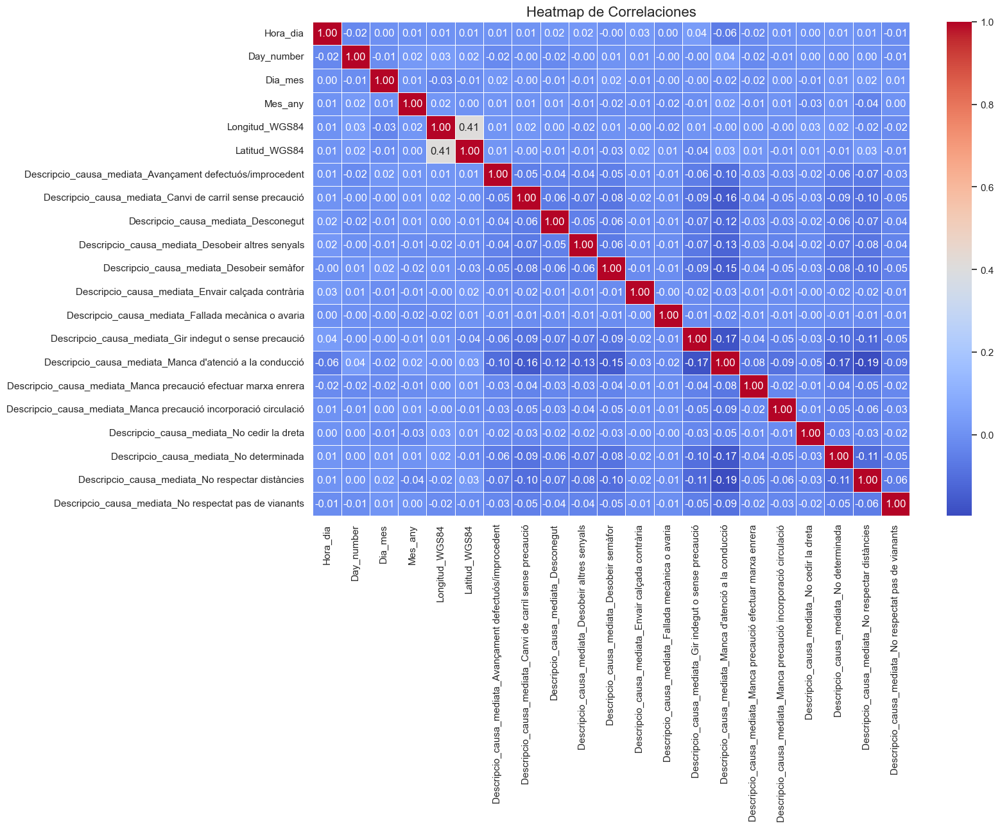

In [418]:
# Calcular la matriz de correlaciones
correlation_matrix = data_fill_ins_reducido_1_dummy_causas.corr()

# Configurar el tamaño del gráfico
plt.figure(figsize=(15, 10))

# Crear el heatmap con Seaborn
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)

# Añadir el título
plt.title('Heatmap de Correlaciones', fontsize=16)

# Mostrar el heatmap
plt.show()


**Siguientes Pasos:**

* Análisis de Distribución: realizar un análisis de la distribución de los datos, tanto numéricos como categóricos.

* Preparación para el Modelo: que todas las columnas relevantes estén en el formato correcto para el modelado y dividir tu conjunto de datos en un conjunto de entrenamiento y otro de prueba.

* Entrenamiento del Modelo: decidir qué modelos deseamos usar. Como no hay unas variables target claras, se puede hacer clasificación utilizando las causas de accidentes (clasificación multi variable) o trabajar con una columna nueva que indique si sí o no hay riesgo de accidente. Sin embargo, todas nuestras observaciones vienen con accidentes (todas serían como un diagnóstigo "positivo") y en el caso de clasificación multi variable, las iferentes clases según los tipos de causas, son muy desigualadas en números. La otra opción serían predicciones con series temporales o métodos con redes neuronales.

**verificar las distribuciones** de las variables numéricas de tu dataset data_fill_ins_reducido_1_dummy_causas usando la prueba de normalidad de Shapiro-Wilk.

Shapiro-Wilk Test: Se aplica a cada columna numérica en el dataset para determinar si sigue una distribución normal.


In [317]:
from scipy.stats import shapiro 
import colorama
from colorama import Fore, Style

# Obtener las columnas del DataFrame
cols = list(data_fill_ins_reducido_1_dummy_causas.columns)

def distr_normal(df):
    normal = []
    for col in df.columns:
        # Realizar la prueba de Shapiro-Wilk y obtener el p-valor
        p_valor = shapiro(df[col])[1]
        normal.append(p_valor > 0.05)  # True si es normal, False si no
    return normal

# Aplicar la función a tu dataset
resultado_distribuciones = distr_normal(data_fill_ins_reducido_1_dummy_causas)

# Mostrar los resultados de la prueba de normalidad
for i, resultado in enumerate(resultado_distribuciones):
    col_name = cols[i]
    if resultado is True: 
        print(Fore.GREEN + f'{col_name}: Normal' + Style.RESET_ALL)
    else: 
        print(Fore.RED + f'{col_name}: No Normal' + Style.RESET_ALL)


Hora_dia: No Normal
Day_number: No Normal
Dia_mes: No Normal
Mes_any: No Normal
Longitud_WGS84: No Normal
Latitud_WGS84: No Normal
Descripcio_causa_mediata_Avançament defectuós/improcedent: No Normal
Descripcio_causa_mediata_Canvi de carril sense precaució: No Normal
Descripcio_causa_mediata_Desconegut: No Normal
Descripcio_causa_mediata_Desobeir altres senyals: No Normal
Descripcio_causa_mediata_Desobeir semàfor: No Normal
Descripcio_causa_mediata_Envair calçada contrària: No Normal
Descripcio_causa_mediata_Fallada mecànica o avaria: No Normal
Descripcio_causa_mediata_Gir indegut o sense precaució: No Normal
Descripcio_causa_mediata_Manca d'atenció a la conducció: No Normal
Descripcio_causa_mediata_Manca precaució efectuar marxa enrera: No Normal
Descripcio_causa_mediata_Manca precaució incorporació circulació: No Normal
Descripcio_causa_mediata_No cedir la dreta: No Normal
Descripcio_causa_mediata_No determinada: No Normal
Descripcio_causa_mediata_No respectar distàncies: No Normal
D

Ninguna variable es de distribución normal. 

**Detección de outliers**

Calcular el porcentaje de outliers por cada columna:

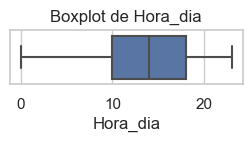

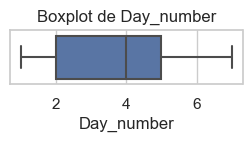

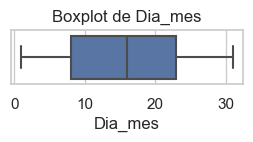

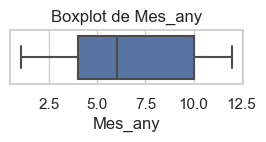

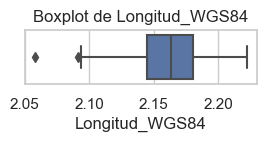

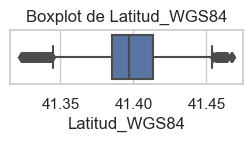

          Columna  Número de Outliers  Porcentaje de Outliers
0        Hora_dia                   0                0.000000
1      Day_number                   0                0.000000
2         Dia_mes                   0                0.000000
3         Mes_any                   0                0.000000
4  Longitud_WGS84                   2                0.022479
5   Latitud_WGS84                 141                1.584804


In [420]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Configurar estilo de Seaborn
sns.set(style="whitegrid")

# Función para calcular outliers y crear un resumen en tabla
def boxplot_outliers(data_transform):
    outlier_summary = []
    
    # Iterar sobre cada columna numérica en data_transform
    for column in data_transform.select_dtypes(include=['int32', 'int64', 'float64']).columns:
        # Eliminar valores NaN de la columna para evitar problemas
        column_data = data_transform[column].dropna()
        
        # Comprobar si la columna no está vacía después de eliminar los NaN
        if len(column_data) > 0:
            plt.figure(figsize=(3, 0.7))
            sns.boxplot(x=column_data)
            plt.title(f'Boxplot de {column}')
            
            # Calcular los outliers usando el rango intercuartílico (IQR)
            Q1 = column_data.quantile(0.25)
            Q3 = column_data.quantile(0.75)
            IQR = Q3 - Q1
            
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            
            # Identificar outliers
            outliers = data_transform[(data_transform[column] < lower_bound) | (data_transform[column] > upper_bound)]
            outlier_count = len(outliers)
            outlier_percentage = outlier_count / len(data_transform) * 100
            
            # Agregar información de outliers al resumen
            outlier_summary.append({
                'Columna': column,
                'Número de Outliers': outlier_count,
                'Porcentaje de Outliers': outlier_percentage
            })
            
            plt.tight_layout()  # Ajustar el diseño del gráfico
            plt.show()
    
    # Crear DataFrame de resumen de outliers
    outlier_summary_df = pd.DataFrame(outlier_summary)
    return outlier_summary_df

# Aplicar la función a tu dataset
outliers_info = boxplot_outliers(data_fill_ins_reducido_1_dummy_causas)

# Mostrar el resumen de outliers
print(outliers_info)


**Escalados:**

Escalados y tratamiento de variables según la presencia de outliers y su naturaleza. Se aplica el escalado correspondiente a cada variable según si tiene outliers o no:

RobustScaler se usa para Longitud_WGS84 y Latitud_WGS84 ya que tienen outliers.
MinMaxScaler se usa para Hora_dia, Day_number, Dia_mes, y Mes_any, que no tienen outliers.

    Crea una copia del dataset original.
    Identifica las columnas numéricas.
    Escala las columnas sin outliers usando MinMaxScaler.
    Escala las columnas con outliers usando RobustScaler.
    Finalmente, se imprime la información del nuevo dataset escalado.

In [319]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler, RobustScaler

# Crear una copia del dataset
data_fill_ins_reducido_1_dummy_causas_scaled = data_fill_ins_reducido_1_dummy_causas.copy()

# Identificar las columnas numéricas
numeric_cols = data_fill_ins_reducido_1_dummy_causas_scaled.select_dtypes(include=['int32', 'float64']).columns

# Inicializar los escaladores
minmax_scaler = MinMaxScaler()
robust_scaler = RobustScaler()

# Escalar columnas sin outliers
no_outliers = ['Hora_dia', 'Day_number', 'Dia_mes', 'Mes_any']
data_fill_ins_reducido_1_dummy_causas_scaled[no_outliers] = minmax_scaler.fit_transform(data_fill_ins_reducido_1_dummy_causas_scaled[no_outliers])

# Escalar columnas con outliers
outlier_cols = ['Longitud_WGS84', 'Latitud_WGS84']
data_fill_ins_reducido_1_dummy_causas_scaled[outlier_cols] = robust_scaler.fit_transform(data_fill_ins_reducido_1_dummy_causas_scaled[outlier_cols])

# Mostrar el resultado
print(data_fill_ins_reducido_1_dummy_causas_scaled.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8897 entries, 0 to 8896
Data columns (total 21 columns):
 #   Column                                                            Non-Null Count  Dtype  
---  ------                                                            --------------  -----  
 0   Hora_dia                                                          8897 non-null   float64
 1   Day_number                                                        8897 non-null   float64
 2   Dia_mes                                                           8897 non-null   float64
 3   Mes_any                                                           8897 non-null   float64
 4   Longitud_WGS84                                                    8897 non-null   float64
 5   Latitud_WGS84                                                     8897 non-null   float64
 6   Descripcio_causa_mediata_Avançament defectuós/improcedent         8897 non-null   bool   
 7   Descripcio_causa_mediata_Canvi de

Vemos que tenemos un conjunto de datos sano y sin datos nulos, pudendo pasar a la etapa siguiente: **data_fill_ins_reducido_1_dummy_causas_scaled**

## **Modelos de machine learning**

Algunos modelos de machine learning para el análisis de accidentes, junto con sus ventajas, desventajas y métricas de evaluación

#### **Clustering**


**K-Nearest Neighbors (KNN)**

Ventajas:

Simple de entender e implementar.
No asume una distribución específica de los datos.
Funciona bien en conjuntos de datos pequeños y con características relevantes.
Desventajas:

Sensible a la escala de los datos y a la presencia de ruido.
Requiere mucho tiempo de cálculo en grandes conjuntos de datos.
Puede ser menos efectivo si los datos son de alta dimensión.
Métricas de Evaluación:

Precisión (Accuracy)
Matriz de confusión
F1 Score (para problemas de clasificación)

**K-Means (Clustering)**

Ventajas:

Simple y fácil de implementar.
Bueno para segmentar los datos y detectar patrones.
Eficiente en términos de computación para grandes conjuntos de datos.
Desventajas:

Sensible a la elección de k (número de clústeres).
Asume que los clústeres son esféricos y de igual tamaño.
No maneja bien los outliers.
Métricas de Evaluación:

Silhouette Score
Inertia (pérdida de suma de distancias a los centros de clúster)
Davies-Bouldin Index

**DBSCAN (Clustering)**

Ventajas:

No requiere especificar el número de clústeres.
Puede encontrar clústeres de forma arbitraria.
Maneja bien el ruido y los outliers.
Desventajas:

Dificultad para elegir parámetros (eps y min_samples).
No funciona bien en datos de alta dimensión.
Métricas de Evaluación:

Silhouette Score
Número de clústeres identificados
Evaluación visual de clústeres


#### **Análisis Geoespacial y Puntos Críticos**

El análisis geoespacial es esencial para identificar patrones en la ocurrencia de accidentes en función de su ubicación. Esta información puede ayudar a las autoridades a implementar medidas de seguridad en puntos críticos.

**Kernel Density Estimation (KDE)**

Descripción:

KDE es una técnica de estimación de densidad que se utiliza para visualizar la distribución de puntos en un espacio geográfico. Se utiliza para convertir un conjunto de puntos en una superficie de densidad, mostrando dónde hay una concentración de accidentes.
Ventajas:

Proporciona una representación visual clara de las concentraciones de accidentes.
No requiere que se especifiquen clústeres de antemano.
Es útil para identificar áreas de alto riesgo y puede ayudar en la planificación urbana.
Desventajas:

La elección del parámetro de ancho de banda puede influir en los resultados.
Puede ser computacionalmente costoso para grandes conjuntos de datos.
Métricas de Evaluación:

Visualización de mapas de densidad.
Comparación de densidades en diferentes zonas.

**DBSCAN (Density-Based Spatial Clustering of Applications with Noise)**

Descripción:

DBSCAN es un algoritmo de clustering basado en densidad que agrupa puntos que están cerca unos de otros, marcando como ruido aquellos que no pertenecen a ningún clúster.
Ventajas:

Puede identificar clústeres de forma arbitraria y manejar el ruido (outliers).
No requiere la especificación previa del número de clústeres.
Eficiente en el manejo de datos espaciales.
Desventajas:

La elección de los parámetros (eps y min_samples) puede ser complicada.
No se desempeña bien en datos de alta dimensión.
Métricas de Evaluación:

Silhouette Score para evaluar la cohesión y separación de los clústeres.
Evaluación visual de los clústeres resultantes en un mapa.

-----------------

Se elige crear los pipelines para entrenar **K-Means** y **DBSCAN** con el **dataset escalado y dummificado** ***data_fill_ins_reducido_1_dummy_causas_scaled***. 


**Importar Librerías y Configurar el Dataset**

In [320]:
# Importar librerías
# Después, cargamos el dataset y preparamos las variables:

import pandas as pd
from sklearn.cluster import KMeans, DBSCAN
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import folium

# Cargar dataset ya escalado y dummificado
data = data_fill_ins_reducido_1_dummy_causas_scaled.copy()

# Seleccionar todas las columnas relevantes, incluidas las dummy de causas

X = data[['Longitud_WGS84', 'Latitud_WGS84', 'Hora_dia', 'Day_number', 'Dia_mes', 'Mes_any'] + 
         [col for col in data.columns if col.startswith('Descripcio_causa_mediata_')]]


Esto incluirá todas las columnas numéricas (coordenadas, tiempo) y también las dummificadas que representan las causas del accidente. K-Means tomará en cuenta las causas de los accidentes al formar los clusters, lo cual puede ayudar a identificar patrones más ricos que solo la ubicación y el tiempo.

**Entrenar el modelo K-Means**:

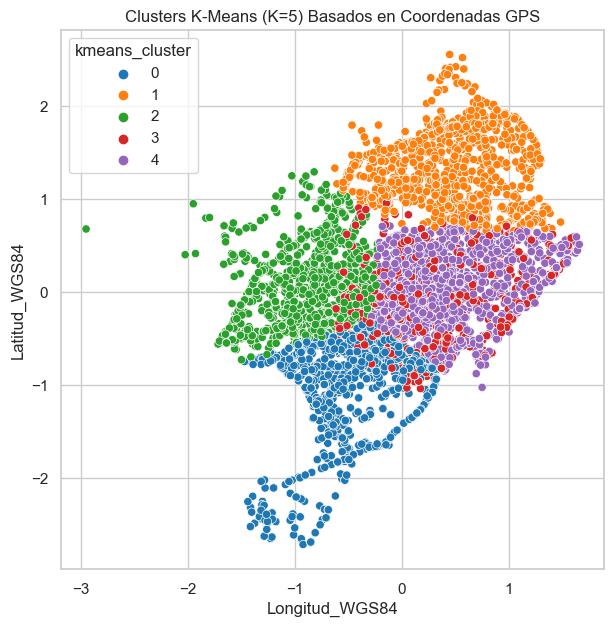

In [323]:
# Pipeline de K-Means con 5 clusters (ajustable según sea necesario)
kmeans_pipeline = Pipeline([
     # Ya tienes los datos escalados
    ('kmeans', KMeans(n_clusters=5, random_state=42))
])

# Entrenar el modelo
kmeans_pipeline.fit(X)

# Predecir los clusters y agregarlos al dataset
data['kmeans_cluster'] = kmeans_pipeline.named_steps['kmeans'].labels_

# Visualización de los clusters con seaborn, aumentando el tamaño de la figura
plt.figure(figsize=(7, 7))  # Tamaño del gráfico aumentado
sns.scatterplot(data=data, x='Longitud_WGS84', y='Latitud_WGS84', hue='kmeans_cluster', palette='tab10')
plt.title('Clusters K-Means (K=5) Basados en Coordenadas GPS')
plt.show()


**Validación del número de clusters con el Método Elbow**

Primero, usaremos el Elbow Method para elegir el mejor valor de k analizando la suma de las distancias cuadradas de cada punto a su centroide (inercia). Este es un buen indicador para ver cuándo agregar más clusters deja de mejorar el modelo significativamente. Con este gráfico, puede observar cuándo la inercia disminuye lentamente, señalando el valor de k más apropiado.

(Lamentablemente algo falla y no consigo hacer funcionar elbow)

**Métricas de Desempeño de Clustering**:Una vez que seleccionao el valor adecuado de **k** basado en el método **Elbow**, se puede calcular las siguientes métricas de desempeño para validar la calidad de los clusters:

* **Silhouette Score**: Mide qué tan cerca están los puntos dentro de un mismo cluster.

* **Davies-Bouldin Index**: Mide la compacidad y la separación de los clusters.

In [325]:
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Ajustar el modelo con el mejor k (supongamos que es k=5)
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Métricas de desempeño
sil_score = silhouette_score(X, kmeans.labels_)
db_score = davies_bouldin_score(X, kmeans.labels_)

print(f'Silhouette Score: {sil_score}')
print(f'Davies-Bouldin Index: {db_score}')


Silhouette Score: 0.12829204953117931
Davies-Bouldin Index: 1.9803345219233788


**Reducción de Dimensionalidad con PCA**

La PCA se utiliza para reducir la dimensionalidad y visualizar los clusters en 2D o 3D. Esto es útil si deseas ver una proyección de tus datos para confirmar que los clusters son coherentes.

Recuperar el dataset original (antes de la escalación, data_fill_ins_reducido_1_dummy_causas).
Agregar las etiquetas de los clusters a ese dataset, para que puedas analizar qué datos corresponden a cada cluster, manteniendo las horas, días, etc., en su formato original.

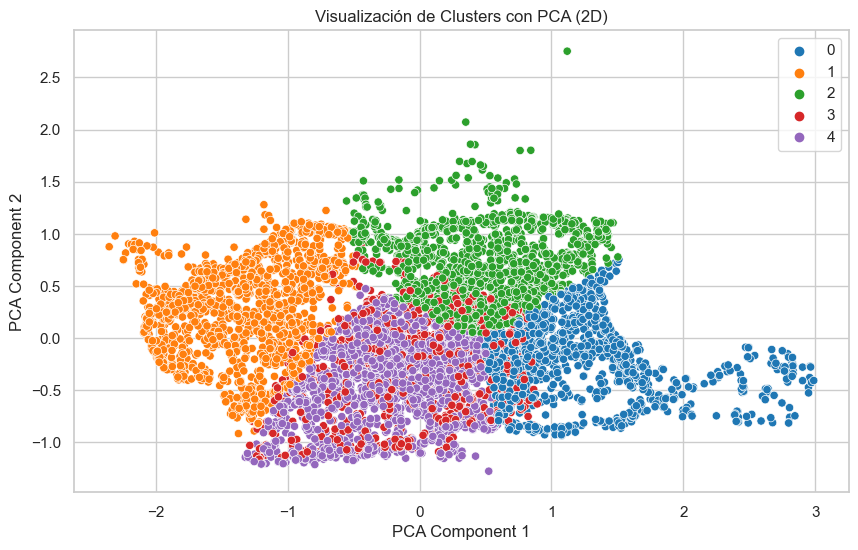

In [338]:
from sklearn.decomposition import PCA

# Reducir los datos a 2 dimensiones para visualización
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Visualizar los clusters en 2D
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=kmeans.labels_, palette='tab10')
plt.title('Visualización de Clusters con PCA (2D)')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.grid(True)
plt.show()


#### **Visualización e Información de los Clusters**

Para ver a qué elementos del dataset corresponden los clusters y cómo están agrupados, agregamos las etiquetas de los clusters al dataset original y luego inspeccionar los datos.

**Agregar los clusters al dataset original**

In [412]:
# O si prefieres, puedes darle un nuevo nombre para el dataset con clusters
data_with_clusters = data_original.copy()

# Inspeccionar el nuevo dataset con clusters
data_with_clusters.head(1)

,Hora_dia,Day_number,Dia_mes,Mes_any,Longitud_WGS84,Latitud_WGS84,Descripcio_causa_mediata_Avançament defectuós/improcedent,Descripcio_causa_mediata_Canvi de carril sense precaució,Descripcio_causa_mediata_Desconegut,Descripcio_causa_mediata_Desobeir altres senyals,...,Descripcio_causa_mediata_Fallada mecànica o avaria,Descripcio_causa_mediata_Gir indegut o sense precaució,Descripcio_causa_mediata_Manca d'atenció a la conducció,Descripcio_causa_mediata_Manca precaució efectuar marxa enrera,Descripcio_causa_mediata_Manca precaució incorporació circulació,Descripcio_causa_mediata_No cedir la dreta,Descripcio_causa_mediata_No determinada,Descripcio_causa_mediata_No respectar distàncies,Descripcio_causa_mediata_No respectat pas de vianants,kmeans_cluster
0,16,6,4,2,2.166596,41.413783,False,False,False,False,...,False,False,True,False,False,False,False,False,False,3


In [413]:
# Dataset original antes de escalar (suponiendo que lo llamaste de esta forma)
data_original = data_fill_ins_reducido_1_dummy_causas.copy()

# Agregar las etiquetas de los clusters al dataset original
data_original['kmeans_cluster'] = kmeans.labels_

# Ver los primeros registros del dataset con los clusters
data_original.head(1)

AttributeError: 'KMeans' object has no attribute 'labels_'

In [376]:
# Dataset original antes de escalar (suponiendo que lo nombraste de esta forma)
# Asegúrate de tener este dataset con las columnas sin escalar
data_original = data_fill_ins_reducido_1_dummy_causas.copy()

# Agregar las etiquetas de los clusters al dataset original
data_original['kmeans_cluster'] = kmeans.labels_


In [375]:
# Agregar los clusters al dataset original

data['kmeans_cluster'] = kmeans.labels_


**Distribución de las Horas en los Clusters**

De manera similar, puedes visualizar cómo las horas del día están distribuidas en cada cluster:

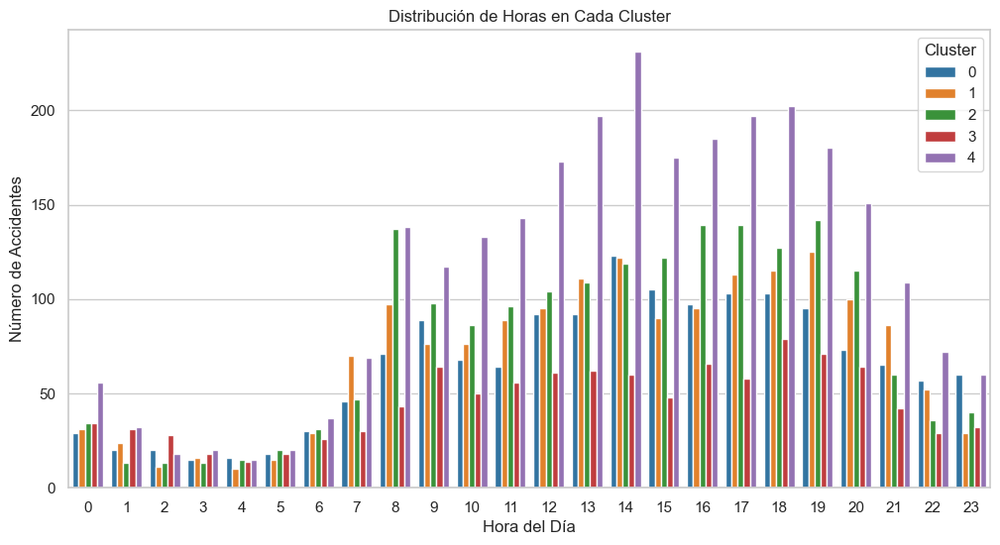

In [331]:
# Gráfico de barras para ver la distribución de las horas por cluster
plt.figure(figsize=(12, 6))
sns.countplot(data=data_original, x='Hora_dia', hue='kmeans_cluster', palette='tab10')
plt.title('Distribución de Horas en Cada Cluster')
plt.xlabel('Hora del Día')
plt.ylabel('Número de Accidentes')
plt.legend(title='Cluster')
plt.show()


Es interesante ver como aumentan los casos de accidentes y en particular, los del clúster 4. Poríamos pensar que éste está relacionado con la causa más frecuente de accidentes, la falta de atención. Entre las horas de almuerzo y meriena, se disparan los accidentes, junto con el nivel de actividad. Luego parece que la gente se tranquiliza a principios de tardepero hay cierto nerviosismo de 15h a 19h, que provoca nuevamente una subida en los accidentes.import seaborn as sns
import matplotlib.pyplot as plt

kmeans_cluster    0    1    2    3    4
Day_number                             
1               224  248  300  167  401
2               223  236  302  171  432
3               268  266  313  162  419
4               261  249  299  167  438
5               236  266  336  159  458
6               200  222  184  123  325
7               139  190  121  135  257


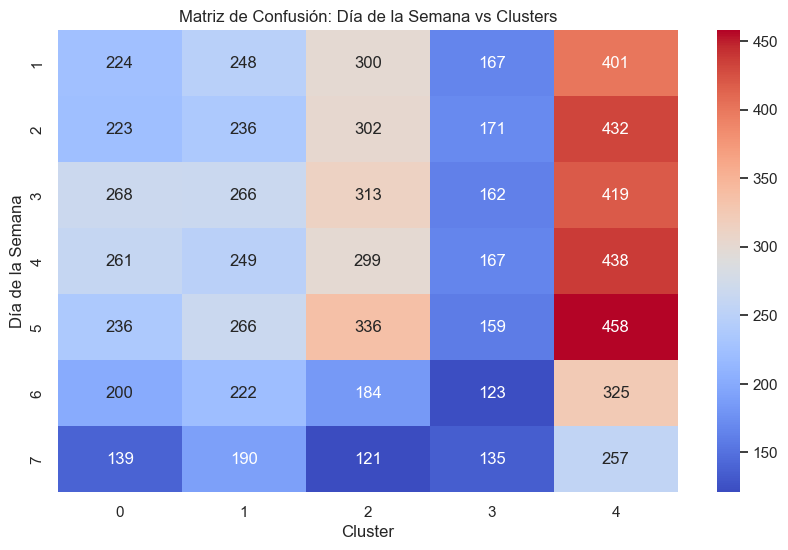

In [342]:
# Matriz de confusión entre el número de día de la semana y los clusters
conf_matrix_dia_cluster = pd.crosstab(data_with_clusters['Day_number'], data_with_clusters['kmeans_cluster'])

# Mostrar la matriz
print(conf_matrix_dia_cluster)

# Opcional: Visualización como heatmap de seaborn
plt.figure(figsize=(10, 6))
sns.heatmap(conf_matrix_dia_cluster, annot=True, cmap='coolwarm', fmt='d')
plt.title('Matriz de Confusión: Día de la Semana vs Clusters')
plt.xlabel('Cluster')
plt.ylabel('Día de la Semana')
plt.show()


**Visualización: Distribución de los Días de la Semana en los Clusters**

El Cluster 4 es el que más accidentes tiene todos los días, y coincide con lo que ya hemos visto en otras gráficas, como la de las horas diarias. 
El Cluster 3 es el que menos accidentes tiene todos los días, menos el domingo, onde el menor número e accidentes es en el 2. Esto hace pensar que podría ser el clúster de circulación nocturna o de zonas con poco tráfico, porque tiene muchos menos accidentes que los demás. También puede ser que haya camptado accidentes de día (lo vemos en el gráfico anterior) pero de otras causa o en calles más pequeñas aunque del centro y del Eixample, que sean diferentes de los otros clústers.

Vemos que cada clúster es muy diferente: el clúster 3 está vinculado poco con cualquier día mientras que el 2 está bastante entre semana delunes a viernes, pero su relación cae los sábaos y  domingos. El cluster 4 está muy vinculado con datos regogidos de lunes a viernes, bastante los sábados y un poco los omingos, lo que hace pensar en los horarios comerciales y la gente que trabaja y/o vive en el centro

kmeans_cluster    0    1    2    3    4
Mes_any                                
1               133  129  143   86  188
2               120  121  150   70  206
3               122  149  157   77  254
4               129  167  169   81  225
5               141  141  193   97  248
6               152  137  176  102  273
7               144  133  155  112  243
8               103   96  110   96  216
9               113  150  142   94  206
10              138  170  169  107  237
11              137  156  160   80  237
12              119  128  131   82  197


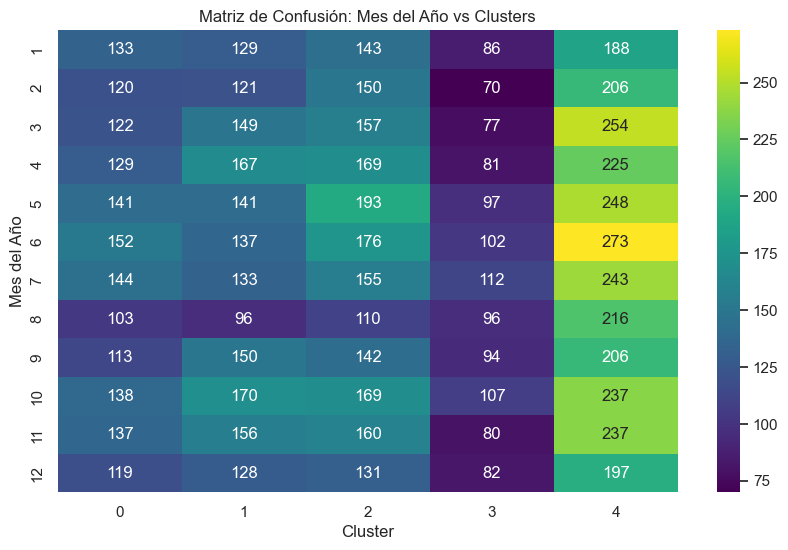

In [365]:
# Matriz de confusión entre el mes del año y los clusters
conf_matrix_mes_cluster = pd.crosstab(data_with_clusters['Mes_any'], data_with_clusters['kmeans_cluster'])

# Mostrar la matriz
print(conf_matrix_mes_cluster)

# Visualización de la matriz de confusión como un heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(conf_matrix_mes_cluster, annot=True, cmap='viridis', fmt='d')
plt.title('Matriz de Confusión: Mes del Año vs Clusters')
plt.xlabel('Cluster')
plt.ylabel('Mes del Año')
plt.show()


**Generar la matriz de confusión de causas de accidentes:**

Ayudará a analizar si los accidentes agrupados en los mismos clusters comparten causas comunes o si existen patrones específicos entre los clusters y las causas.

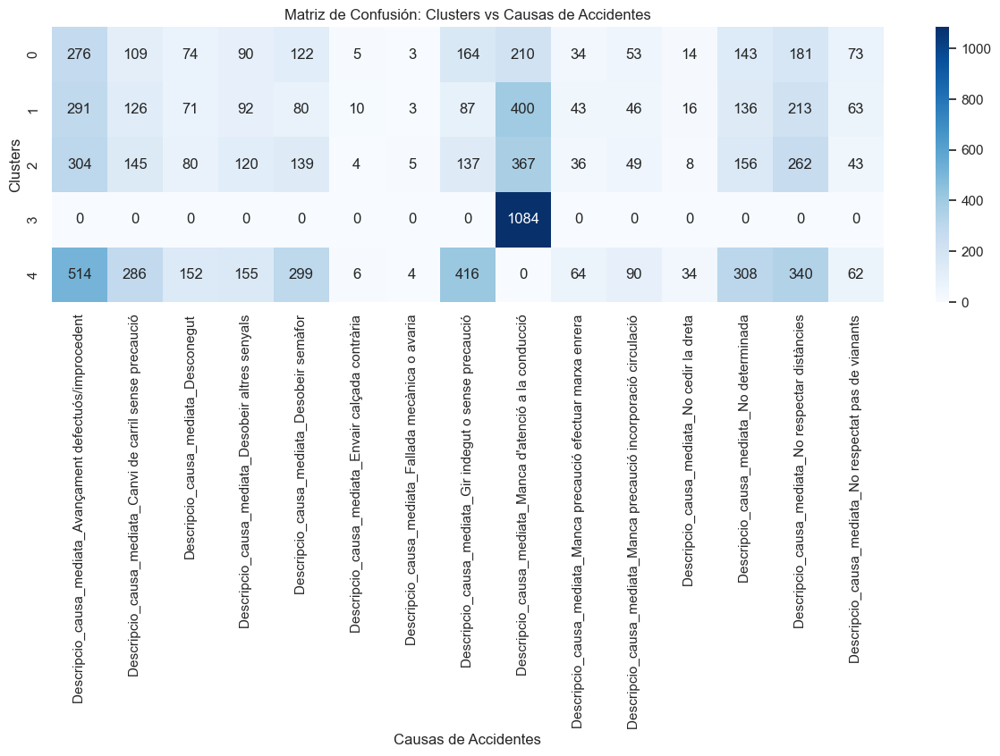

In [373]:
# Seleccionar las columnas de causas de accidentes
causas_columns = [col for col in data_original.columns if col.startswith('Descripcio_causa_mediata_')]

# Generar la matriz de confusión entre clusters y causas
matriz_confusion_causas = pd.crosstab(data_original['kmeans_cluster'], data_original[causas_columns].idxmax(axis=1))

# Visualizar la matriz de confusión como un mapa de calor
plt.figure(figsize=(15, 4))
sns.heatmap(matriz_confusion_causas, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de Confusión: Clusters vs Causas de Accidentes')
plt.ylabel('Clusters')
plt.xlabel('Causas de Accidentes')
plt.show()


Finalmente, estamos viendo como en el año 2023 los accidentes por falta de atención y despistes en la conducción han sido los más numerosos y están completamente recogidos en el Cluster 3, pudiendose tratar de día o e noche, pero antes vimos que el Cluster 3 es bastante presente en horas diurnas (gráfico de barras anteriores).

Vemos aquí como el Cluster 4 está vinculado al nerviosismo al volante y no al despiste, como con adelantamiento improcedente, giro indebido o desobedecer semáforo, no respetar distancias. 

## **Conclusión**

**Interpretación de las métricas obtenidas con K-Means:**

**El Silhouette Score** mide qué tan similares son los puntos dentro de un mismo clúster comparados con puntos de otros clústers.
    Valores cercanos a 1 indican que los clústers están bien definidos (los puntos están cerca de los puntos del mismo clúster y lejos de los de otros clústers).
    Valores cercanos a 0 indican que los puntos están muy cerca del límite entre clústers.
    Valores negativos significan que los puntos probablemente se han asignado a clústers incorrectos.
    **Resultado: 0.128**. Un valor de 0.128 es bajo, lo que sugiere que los clústers no están claramente separados, es decir, muchos puntos están cercanos a los bordes entre clústers o los clústers no son muy compactos.

**Davies-Bouldin Index**: El Davies-Bouldin Index (DBI) mide la calidad de los clústers basándose en la relación entre la distancia promedio entre los puntos en un clúster y la distancia entre los clústers.
    Valores cercanos a 0 indican clústers bien definidos y bien separados (menor es mejor).
    **Resultado: 1.98**. Un índice de 1.98 indica que los **clústers están razonablemente separados, pero no es excelente**. Valores bajos son mejores, y un DBI menor a 1 se considera bueno.

**¿Qué significa este resultado?**

Silhouette Score (0.128) es bajo, lo que indica que los **clústers podrían no estar bien separados o que existe cierta confusión en los bordes de los clústers**. Podría ser un indicio de que los datos no se ajustan bien al **modelo de K-Means**.
**Davies-Bouldin Index (1.98) es moderado**, lo que sugiere que los clústers tienen cierta separación, pero podría mejorar.

Tanto el Silhouette Score bajo como el DBI moderado indican que los clústers **no están claramente definidos y hay solapamiento entre ellos**. 

**Mejoras posibles**:

El número de clústers no es óptimo (probar con otros valores de k).
Los datos no están bien distribuidos para el modelo K-Means (quizás deberías probar con otros modelos como DBSCAN).
La selección de variables podría mejorar agregando o quitando columnas (como usar distritos o barrios, o explorar mejor los datos antes del clustering), experimentar con más columnas.

¿Debería haber **más columnas y más columnas dummificadas** en lugar de escaladas? Es correcto que algunas variables, como las dummies de las causas de los accidentes, ya se encuentran en formato booleano y no necesitan ser escaladas, ya que su naturaleza es binaria (0 o 1). Sin embargo, las variables como distritos, barrios, incluso días de la semana, o meses, pueden ser categóricas (las de lugar, seguro y las de tiempo me han generado dudas). Ellas son o pueden ser categóricas, podrían haberse dummificado también, en lugar de simplemente transformarlas a enteros. Esto puede ser importante para que los algoritmos de clustering interpreten correctamente estas variables, ya que los valores enteros podrían inducir una relación ordinal que en realidad no existe.